# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
ratio_true=0.6

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: kzpsu7wc
Name: tusken-xwing-144
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/kzpsu7wc
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155912-kzpsu7wc/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2538,3253,9452
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2538,2553,1698,3422,1654,3378
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4442,10801
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 667,856,2287
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 667,649,410,868,395,821
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1142,2668
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:12<2:09:39, 12.99s/it]

Epoch 1/600:   0%|          | 1/600 [00:12<2:09:39, 12.99s/it, v_num=wc_1, total_loss_train=1.84e+3, kl_local_train=56]

Epoch 2/600:   0%|          | 1/600 [00:13<2:09:39, 12.99s/it, v_num=wc_1, total_loss_train=1.84e+3, kl_local_train=56]

Epoch 2/600:   0%|          | 2/600 [00:24<2:02:37, 12.30s/it, v_num=wc_1, total_loss_train=1.84e+3, kl_local_train=56]

Epoch 2/600:   0%|          | 2/600 [00:24<2:02:37, 12.30s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=89.7]

Epoch 3/600:   0%|          | 2/600 [00:24<2:02:37, 12.30s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=89.7]

Epoch 3/600:   0%|          | 3/600 [00:36<1:59:59, 12.06s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=89.7]

Epoch 3/600:   0%|          | 3/600 [00:36<1:59:59, 12.06s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=91.4]

Epoch 4/600:   0%|          | 3/600 [00:36<1:59:59, 12.06s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=91.4]

Epoch 4/600:   1%|          | 4/600 [00:48<1:58:40, 11.95s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=91.4]

Epoch 4/600:   1%|          | 4/600 [00:48<1:58:40, 11.95s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=85]  

Epoch 5/600:   1%|          | 4/600 [00:48<1:58:40, 11.95s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=85]

Epoch 5/600:   1%|          | 5/600 [01:00<1:58:18, 11.93s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=85]

Epoch 5/600:   1%|          | 5/600 [01:00<1:58:18, 11.93s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=73.2]

Epoch 6/600:   1%|          | 5/600 [01:01<1:58:18, 11.93s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=73.2]

Epoch 6/600:   1%|          | 6/600 [01:12<1:59:38, 12.08s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=73.2]

Epoch 6/600:   1%|          | 6/600 [01:12<1:59:38, 12.08s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:12<1:59:38, 12.08s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:23<1:56:45, 11.81s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:23<1:56:45, 11.81s/it, v_num=wc_1, total_loss_train=1.3e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349] 

Epoch 8/600:   1%|          | 7/600 [01:23<1:56:45, 11.81s/it, v_num=wc_1, total_loss_train=1.3e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:35<1:54:35, 11.61s/it, v_num=wc_1, total_loss_train=1.3e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:35<1:54:35, 11.61s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=23, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349] 

Epoch 9/600:   1%|▏         | 8/600 [01:35<1:54:35, 11.61s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=23, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:46<1:53:05, 11.48s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=23, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:46<1:53:05, 11.48s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=34.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [01:46<1:53:05, 11.48s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=34.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [01:57<1:52:22, 11.43s/it, v_num=wc_1, total_loss_train=1.31e+3, kl_local_train=34.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [01:57<1:52:22, 11.43s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [01:58<1:52:22, 11.43s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:10<1:55:20, 11.75s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00766, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:10<1:55:20, 11.75s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=148, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]   

Epoch 12/600:   2%|▏         | 11/600 [02:10<1:55:20, 11.75s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=148, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 12/600:   2%|▏         | 12/600 [02:21<1:53:29, 11.58s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=148, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 12/600:   2%|▏         | 12/600 [02:21<1:53:29, 11.58s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=134, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 13/600:   2%|▏         | 12/600 [02:21<1:53:29, 11.58s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=134, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 13/600:   2%|▏         | 13/600 [02:32<1:52:10, 11.47s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=134, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 13/600:   2%|▏         | 13/600 [02:32<1:52:10, 11.47s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=136, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 14/600:   2%|▏         | 13/600 [02:32<1:52:10, 11.47s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=136, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 14/600:   2%|▏         | 14/600 [02:43<1:51:10, 11.38s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=136, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 14/600:   2%|▏         | 14/600 [02:43<1:51:10, 11.38s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=137, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 15/600:   2%|▏         | 14/600 [02:43<1:51:10, 11.38s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=137, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 15/600:   2%|▎         | 15/600 [02:54<1:50:42, 11.36s/it, v_num=wc_1, total_loss_train=1.32e+3, kl_local_train=137, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 15/600:   2%|▎         | 15/600 [02:54<1:50:42, 11.36s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=140, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 16/600:   2%|▎         | 15/600 [02:56<1:50:42, 11.36s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=140, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 16/600:   3%|▎         | 16/600 [03:07<1:53:48, 11.69s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=140, metric_mi|status_control_train=0.0201, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.021, metric_mi|mouse_train=0.0437]

Epoch 16/600:   3%|▎         | 16/600 [03:07<1:53:48, 11.69s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=175, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 17/600:   3%|▎         | 16/600 [03:07<1:53:48, 11.69s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=175, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 17/600:   3%|▎         | 17/600 [03:18<1:52:12, 11.55s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=175, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 17/600:   3%|▎         | 17/600 [03:18<1:52:12, 11.55s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=176, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 18/600:   3%|▎         | 17/600 [03:18<1:52:12, 11.55s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=176, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 18/600:   3%|▎         | 18/600 [03:29<1:51:06, 11.46s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=176, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 18/600:   3%|▎         | 18/600 [03:29<1:51:06, 11.46s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 19/600:   3%|▎         | 18/600 [03:29<1:51:06, 11.46s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 19/600:   3%|▎         | 19/600 [03:41<1:50:14, 11.39s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 19/600:   3%|▎         | 19/600 [03:41<1:50:14, 11.39s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=170, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 20/600:   3%|▎         | 19/600 [03:41<1:50:14, 11.39s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=170, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 20/600:   3%|▎         | 20/600 [03:52<1:49:51, 11.36s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=170, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 20/600:   3%|▎         | 20/600 [03:52<1:49:51, 11.36s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 21/600:   3%|▎         | 20/600 [03:53<1:49:51, 11.36s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 21/600:   4%|▎         | 21/600 [04:04<1:52:59, 11.71s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0725]

Epoch 21/600:   4%|▎         | 21/600 [04:04<1:52:59, 11.71s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=171, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]    

Epoch 22/600:   4%|▎         | 21/600 [04:04<1:52:59, 11.71s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=171, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 22/600:   4%|▎         | 22/600 [04:16<1:51:33, 11.58s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=171, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 22/600:   4%|▎         | 22/600 [04:16<1:51:33, 11.58s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 23/600:   4%|▎         | 22/600 [04:16<1:51:33, 11.58s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 23/600:   4%|▍         | 23/600 [04:27<1:50:30, 11.49s/it, v_num=wc_1, total_loss_train=1.33e+3, kl_local_train=172, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 23/600:   4%|▍         | 23/600 [04:27<1:50:30, 11.49s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=172, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 24/600:   4%|▍         | 23/600 [04:27<1:50:30, 11.49s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=172, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 24/600:   4%|▍         | 24/600 [04:38<1:49:42, 11.43s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=172, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 24/600:   4%|▍         | 24/600 [04:38<1:49:42, 11.43s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=173, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 25/600:   4%|▍         | 24/600 [04:38<1:49:42, 11.43s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=173, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 25/600:   4%|▍         | 25/600 [04:50<1:49:35, 11.44s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=173, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 25/600:   4%|▍         | 25/600 [04:50<1:49:35, 11.44s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=174, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 26/600:   4%|▍         | 25/600 [04:51<1:49:35, 11.44s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=174, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 26/600:   4%|▍         | 26/600 [05:02<1:52:45, 11.79s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=174, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 26/600:   4%|▍         | 26/600 [05:02<1:52:45, 11.79s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=173, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 27/600:   4%|▍         | 26/600 [05:02<1:52:45, 11.79s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=173, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 27/600:   4%|▍         | 27/600 [05:14<1:51:58, 11.73s/it, v_num=wc_1, total_loss_train=1.34e+3, kl_local_train=173, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 27/600:   4%|▍         | 27/600 [05:14<1:51:58, 11.73s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=171, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 28/600:   4%|▍         | 27/600 [05:14<1:51:58, 11.73s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=171, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 28/600:   5%|▍         | 28/600 [05:25<1:50:40, 11.61s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=171, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 28/600:   5%|▍         | 28/600 [05:25<1:50:40, 11.61s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=170, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 29/600:   5%|▍         | 28/600 [05:25<1:50:40, 11.61s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=170, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 29/600:   5%|▍         | 29/600 [05:37<1:49:40, 11.52s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=170, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 29/600:   5%|▍         | 29/600 [05:37<1:49:40, 11.52s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=174, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 30/600:   5%|▍         | 29/600 [05:37<1:49:40, 11.52s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=174, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 30/600:   5%|▌         | 30/600 [05:48<1:48:58, 11.47s/it, v_num=wc_1, total_loss_train=1.35e+3, kl_local_train=174, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 30/600:   5%|▌         | 30/600 [05:48<1:48:58, 11.47s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=174, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 31/600:   5%|▌         | 30/600 [05:49<1:48:58, 11.47s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=174, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 31/600:   5%|▌         | 31/600 [06:00<1:51:45, 11.79s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=174, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 31/600:   5%|▌         | 31/600 [06:00<1:51:45, 11.79s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=172, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 32/600:   5%|▌         | 31/600 [06:00<1:51:45, 11.79s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=172, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 32/600:   5%|▌         | 32/600 [06:12<1:50:07, 11.63s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=172, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 32/600:   5%|▌         | 32/600 [06:12<1:50:07, 11.63s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 33/600:   5%|▌         | 32/600 [06:12<1:50:07, 11.63s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 33/600:   6%|▌         | 33/600 [06:23<1:48:49, 11.52s/it, v_num=wc_1, total_loss_train=1.36e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 33/600:   6%|▌         | 33/600 [06:23<1:48:49, 11.52s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 34/600:   6%|▌         | 33/600 [06:23<1:48:49, 11.52s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 34/600:   6%|▌         | 34/600 [06:34<1:47:50, 11.43s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 34/600:   6%|▌         | 34/600 [06:34<1:47:50, 11.43s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=169, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 35/600:   6%|▌         | 34/600 [06:34<1:47:50, 11.43s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=169, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 35/600:   6%|▌         | 35/600 [06:46<1:47:22, 11.40s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=169, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 35/600:   6%|▌         | 35/600 [06:46<1:47:22, 11.40s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=172, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 36/600:   6%|▌         | 35/600 [06:47<1:47:22, 11.40s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=172, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 36/600:   6%|▌         | 36/600 [06:58<1:50:21, 11.74s/it, v_num=wc_1, total_loss_train=1.37e+3, kl_local_train=172, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 36/600:   6%|▌         | 36/600 [06:58<1:50:21, 11.74s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=167, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 37/600:   6%|▌         | 36/600 [06:58<1:50:21, 11.74s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=167, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 37/600:   6%|▌         | 37/600 [07:09<1:48:52, 11.60s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=167, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 37/600:   6%|▌         | 37/600 [07:09<1:48:52, 11.60s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=169, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 38/600:   6%|▌         | 37/600 [07:09<1:48:52, 11.60s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=169, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 38/600:   6%|▋         | 38/600 [07:21<1:47:43, 11.50s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=169, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 38/600:   6%|▋         | 38/600 [07:21<1:47:43, 11.50s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 39/600:   6%|▋         | 38/600 [07:21<1:47:43, 11.50s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 39/600:   6%|▋         | 39/600 [07:32<1:46:50, 11.43s/it, v_num=wc_1, total_loss_train=1.38e+3, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 39/600:   6%|▋         | 39/600 [07:32<1:46:50, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 40/600:   6%|▋         | 39/600 [07:32<1:46:50, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 40/600:   7%|▋         | 40/600 [07:44<1:47:32, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=166, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 40/600:   7%|▋         | 40/600 [07:44<1:47:32, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 41/600:   7%|▋         | 40/600 [07:45<1:47:32, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 41/600:   7%|▋         | 41/600 [07:56<1:50:08, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.152]

Epoch 41/600:   7%|▋         | 41/600 [07:56<1:50:08, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149] 

Epoch 42/600:   7%|▋         | 41/600 [07:56<1:50:08, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 42/600:   7%|▋         | 42/600 [08:07<1:48:22, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 42/600:   7%|▋         | 42/600 [08:07<1:48:22, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149] 

Epoch 43/600:   7%|▋         | 42/600 [08:07<1:48:22, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 43/600:   7%|▋         | 43/600 [08:19<1:47:07, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 43/600:   7%|▋         | 43/600 [08:19<1:47:07, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 44/600:   7%|▋         | 43/600 [08:19<1:47:07, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 44/600:   7%|▋         | 44/600 [08:30<1:46:09, 11.46s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=165, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 44/600:   7%|▋         | 44/600 [08:30<1:46:09, 11.46s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=167, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 45/600:   7%|▋         | 44/600 [08:30<1:46:09, 11.46s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=167, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 45/600:   8%|▊         | 45/600 [08:42<1:46:45, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=167, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 45/600:   8%|▊         | 45/600 [08:42<1:46:45, 11.54s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 46/600:   8%|▊         | 45/600 [08:43<1:46:45, 11.54s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 46/600:   8%|▊         | 46/600 [08:54<1:49:15, 11.83s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=166, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.149]

Epoch 46/600:   8%|▊         | 46/600 [08:54<1:49:15, 11.83s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 47/600:   8%|▊         | 46/600 [08:54<1:49:15, 11.83s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 47/600:   8%|▊         | 47/600 [09:05<1:47:32, 11.67s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=168, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 47/600:   8%|▊         | 47/600 [09:05<1:47:32, 11.67s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=170, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 48/600:   8%|▊         | 47/600 [09:05<1:47:32, 11.67s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=170, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 48/600:   8%|▊         | 48/600 [09:17<1:46:21, 11.56s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=170, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 48/600:   8%|▊         | 48/600 [09:17<1:46:21, 11.56s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=169, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 49/600:   8%|▊         | 48/600 [09:17<1:46:21, 11.56s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=169, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 49/600:   8%|▊         | 49/600 [09:28<1:45:22, 11.47s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=169, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 49/600:   8%|▊         | 49/600 [09:28<1:45:22, 11.47s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=170, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 50/600:   8%|▊         | 49/600 [09:28<1:45:22, 11.47s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=170, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 50/600:   8%|▊         | 50/600 [09:39<1:44:38, 11.41s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=170, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 50/600:   8%|▊         | 50/600 [09:39<1:44:38, 11.41s/it, v_num=wc_1, total_loss_train=1.43e+3, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 51/600:   8%|▊         | 50/600 [09:41<1:44:38, 11.41s/it, v_num=wc_1, total_loss_train=1.43e+3, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 51/600:   8%|▊         | 51/600 [09:52<1:47:34, 11.76s/it, v_num=wc_1, total_loss_train=1.43e+3, kl_local_train=167, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.149]

Epoch 51/600:   8%|▊         | 51/600 [09:52<1:47:34, 11.76s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=165, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]  

Epoch 52/600:   8%|▊         | 51/600 [09:52<1:47:34, 11.76s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=165, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 52/600:   9%|▊         | 52/600 [10:03<1:46:03, 11.61s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=165, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 52/600:   9%|▊         | 52/600 [10:03<1:46:03, 11.61s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=162, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|▊         | 52/600 [10:03<1:46:03, 11.61s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=162, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|▉         | 53/600 [10:14<1:45:06, 11.53s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=162, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 53/600:   9%|▉         | 53/600 [10:14<1:45:06, 11.53s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=164, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|▉         | 53/600 [10:14<1:45:06, 11.53s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=164, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|▉         | 54/600 [10:26<1:44:52, 11.53s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=164, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 54/600:   9%|▉         | 54/600 [10:26<1:44:52, 11.53s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|▉         | 54/600 [10:26<1:44:52, 11.53s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|▉         | 55/600 [10:37<1:44:37, 11.52s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 55/600:   9%|▉         | 55/600 [10:38<1:44:37, 11.52s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|▉         | 55/600 [10:39<1:44:37, 11.52s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|▉         | 56/600 [10:50<1:47:11, 11.82s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.15]

Epoch 56/600:   9%|▉         | 56/600 [10:50<1:47:11, 11.82s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 57/600:   9%|▉         | 56/600 [10:50<1:47:11, 11.82s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 57/600:  10%|▉         | 57/600 [11:02<1:46:23, 11.76s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 57/600:  10%|▉         | 57/600 [11:02<1:46:23, 11.76s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 58/600:  10%|▉         | 57/600 [11:02<1:46:23, 11.76s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 58/600:  10%|▉         | 58/600 [11:13<1:45:53, 11.72s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=161, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 58/600:  10%|▉         | 58/600 [11:13<1:45:53, 11.72s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 59/600:  10%|▉         | 58/600 [11:13<1:45:53, 11.72s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 59/600:  10%|▉         | 59/600 [11:25<1:45:26, 11.69s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 59/600:  10%|▉         | 59/600 [11:25<1:45:26, 11.69s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=155, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 60/600:  10%|▉         | 59/600 [11:25<1:45:26, 11.69s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=155, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 60/600:  10%|█         | 60/600 [11:37<1:45:30, 11.72s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=155, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 60/600:  10%|█         | 60/600 [11:37<1:45:30, 11.72s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 61/600:  10%|█         | 60/600 [11:38<1:45:30, 11.72s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 61/600:  10%|█         | 61/600 [11:50<1:48:26, 12.07s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=159, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.148]

Epoch 61/600:  10%|█         | 61/600 [11:50<1:48:26, 12.07s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=156, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146] 

Epoch 62/600:  10%|█         | 61/600 [11:50<1:48:26, 12.07s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=156, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|█         | 62/600 [12:01<1:47:08, 11.95s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=156, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 62/600:  10%|█         | 62/600 [12:01<1:47:08, 11.95s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=153, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|█         | 62/600 [12:01<1:47:08, 11.95s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=153, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|█         | 63/600 [12:13<1:46:04, 11.85s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=153, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 63/600:  10%|█         | 63/600 [12:13<1:46:04, 11.85s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=155, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 64/600:  10%|█         | 63/600 [12:13<1:46:04, 11.85s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=155, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 64/600:  11%|█         | 64/600 [12:25<1:45:20, 11.79s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=155, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 64/600:  11%|█         | 64/600 [12:25<1:45:20, 11.79s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=153, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|█         | 64/600 [12:25<1:45:20, 11.79s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=153, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|█         | 65/600 [12:36<1:45:12, 11.80s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=153, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 65/600:  11%|█         | 65/600 [12:36<1:45:12, 11.80s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=151, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|█         | 65/600 [12:38<1:45:12, 11.80s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=151, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|█         | 66/600 [12:49<1:46:56, 12.02s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=151, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 66/600:  11%|█         | 66/600 [12:49<1:46:56, 12.02s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=149, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|█         | 66/600 [12:49<1:46:56, 12.02s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=149, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|█         | 67/600 [13:00<1:45:01, 11.82s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=149, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 67/600:  11%|█         | 67/600 [13:00<1:45:01, 11.82s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=150, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|█         | 67/600 [13:00<1:45:01, 11.82s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=150, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|█▏        | 68/600 [13:12<1:43:42, 11.70s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=150, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 68/600:  11%|█▏        | 68/600 [13:12<1:43:42, 11.70s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 69/600:  11%|█▏        | 68/600 [13:12<1:43:42, 11.70s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 69/600:  12%|█▏        | 69/600 [13:23<1:42:43, 11.61s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=148, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 69/600:  12%|█▏        | 69/600 [13:23<1:42:43, 11.61s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|█▏        | 69/600 [13:23<1:42:43, 11.61s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|█▏        | 70/600 [13:35<1:42:58, 11.66s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 70/600:  12%|█▏        | 70/600 [13:35<1:42:58, 11.66s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|█▏        | 70/600 [13:36<1:42:58, 11.66s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|█▏        | 71/600 [13:47<1:44:55, 11.90s/it, v_num=wc_1, total_loss_train=1.42e+3, kl_local_train=147, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 71/600:  12%|█▏        | 71/600 [13:47<1:44:55, 11.90s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 72/600:  12%|█▏        | 71/600 [13:47<1:44:55, 11.90s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 72/600:  12%|█▏        | 72/600 [13:59<1:43:21, 11.74s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 72/600:  12%|█▏        | 72/600 [13:59<1:43:21, 11.74s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 73/600:  12%|█▏        | 72/600 [13:59<1:43:21, 11.74s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 73/600:  12%|█▏        | 73/600 [14:10<1:42:15, 11.64s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 73/600:  12%|█▏        | 73/600 [14:10<1:42:15, 11.64s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 74/600:  12%|█▏        | 73/600 [14:10<1:42:15, 11.64s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 74/600:  12%|█▏        | 74/600 [14:21<1:41:28, 11.58s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 74/600:  12%|█▏        | 74/600 [14:21<1:41:28, 11.58s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 75/600:  12%|█▏        | 74/600 [14:21<1:41:28, 11.58s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 75/600:  12%|█▎        | 75/600 [14:33<1:41:14, 11.57s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 75/600:  12%|█▎        | 75/600 [14:33<1:41:14, 11.57s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 76/600:  12%|█▎        | 75/600 [14:34<1:41:14, 11.57s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 76/600:  13%|█▎        | 76/600 [14:46<1:43:40, 11.87s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 76/600:  13%|█▎        | 76/600 [14:46<1:43:40, 11.87s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 77/600:  13%|█▎        | 76/600 [14:46<1:43:40, 11.87s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 77/600:  13%|█▎        | 77/600 [14:57<1:42:14, 11.73s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 77/600:  13%|█▎        | 77/600 [14:57<1:42:14, 11.73s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 78/600:  13%|█▎        | 77/600 [14:57<1:42:14, 11.73s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 78/600:  13%|█▎        | 78/600 [15:08<1:41:05, 11.62s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 78/600:  13%|█▎        | 78/600 [15:08<1:41:05, 11.62s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 79/600:  13%|█▎        | 78/600 [15:08<1:41:05, 11.62s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 79/600:  13%|█▎        | 79/600 [15:20<1:40:29, 11.57s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 79/600:  13%|█▎        | 79/600 [15:20<1:40:29, 11.57s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=141, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 80/600:  13%|█▎        | 79/600 [15:20<1:40:29, 11.57s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=141, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 80/600:  13%|█▎        | 80/600 [15:32<1:41:13, 11.68s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=141, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 80/600:  13%|█▎        | 80/600 [15:32<1:41:13, 11.68s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 81/600:  13%|█▎        | 80/600 [15:33<1:41:13, 11.68s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 81/600:  14%|█▎        | 81/600 [15:44<1:43:23, 11.95s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=142, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.148]

Epoch 81/600:  14%|█▎        | 81/600 [15:44<1:43:23, 11.95s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 82/600:  14%|█▎        | 81/600 [15:44<1:43:23, 11.95s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 82/600:  14%|█▎        | 82/600 [15:56<1:41:44, 11.79s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 82/600:  14%|█▎        | 82/600 [15:56<1:41:44, 11.79s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 83/600:  14%|█▎        | 82/600 [15:56<1:41:44, 11.79s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 83/600:  14%|█▍        | 83/600 [16:07<1:40:44, 11.69s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=143, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 83/600:  14%|█▍        | 83/600 [16:07<1:40:44, 11.69s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=141, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 84/600:  14%|█▍        | 83/600 [16:07<1:40:44, 11.69s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=141, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 84/600:  14%|█▍        | 84/600 [16:19<1:39:57, 11.62s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=141, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 84/600:  14%|█▍        | 84/600 [16:19<1:39:57, 11.62s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=140, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 85/600:  14%|█▍        | 84/600 [16:19<1:39:57, 11.62s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=140, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 85/600:  14%|█▍        | 85/600 [16:30<1:40:13, 11.68s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=140, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 85/600:  14%|█▍        | 85/600 [16:30<1:40:13, 11.68s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=138, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 86/600:  14%|█▍        | 85/600 [16:32<1:40:13, 11.68s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=138, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 86/600:  14%|█▍        | 86/600 [16:43<1:42:17, 11.94s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=138, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.149]

Epoch 86/600:  14%|█▍        | 86/600 [16:43<1:42:17, 11.94s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=138, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 87/600:  14%|█▍        | 86/600 [16:43<1:42:17, 11.94s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=138, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 87/600:  14%|█▍        | 87/600 [16:54<1:40:41, 11.78s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=138, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 87/600:  14%|█▍        | 87/600 [16:54<1:40:41, 11.78s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=137, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 88/600:  14%|█▍        | 87/600 [16:54<1:40:41, 11.78s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=137, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 88/600:  15%|█▍        | 88/600 [17:06<1:39:32, 11.67s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=137, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 88/600:  15%|█▍        | 88/600 [17:06<1:39:32, 11.67s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=136, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 89/600:  15%|█▍        | 88/600 [17:06<1:39:32, 11.67s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=136, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 89/600:  15%|█▍        | 89/600 [17:17<1:38:28, 11.56s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=136, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 89/600:  15%|█▍        | 89/600 [17:17<1:38:28, 11.56s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=135, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 90/600:  15%|█▍        | 89/600 [17:17<1:38:28, 11.56s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=135, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 90/600:  15%|█▌        | 90/600 [17:29<1:38:15, 11.56s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=135, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 90/600:  15%|█▌        | 90/600 [17:29<1:38:15, 11.56s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=134, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 91/600:  15%|█▌        | 90/600 [17:30<1:38:15, 11.56s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=134, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 91/600:  15%|█▌        | 91/600 [17:41<1:40:34, 11.86s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=134, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 91/600:  15%|█▌        | 91/600 [17:41<1:40:34, 11.86s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153] 

Epoch 92/600:  15%|█▌        | 91/600 [17:41<1:40:34, 11.86s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 92/600:  15%|█▌        | 92/600 [17:53<1:39:02, 11.70s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 92/600:  15%|█▌        | 92/600 [17:53<1:39:02, 11.70s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 93/600:  15%|█▌        | 92/600 [17:53<1:39:02, 11.70s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 93/600:  16%|█▌        | 93/600 [18:04<1:37:54, 11.59s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 93/600:  16%|█▌        | 93/600 [18:04<1:37:54, 11.59s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 94/600:  16%|█▌        | 93/600 [18:04<1:37:54, 11.59s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 94/600:  16%|█▌        | 94/600 [18:15<1:37:04, 11.51s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 94/600:  16%|█▌        | 94/600 [18:15<1:37:04, 11.51s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 95/600:  16%|█▌        | 94/600 [18:15<1:37:04, 11.51s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 95/600:  16%|█▌        | 95/600 [18:27<1:37:40, 11.60s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 95/600:  16%|█▌        | 95/600 [18:27<1:37:40, 11.60s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 96/600:  16%|█▌        | 95/600 [18:28<1:37:40, 11.60s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 96/600:  16%|█▌        | 96/600 [18:40<1:39:56, 11.90s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.153]

Epoch 96/600:  16%|█▌        | 96/600 [18:40<1:39:56, 11.90s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=130, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 97/600:  16%|█▌        | 96/600 [18:40<1:39:56, 11.90s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=130, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 97/600:  16%|█▌        | 97/600 [18:51<1:38:18, 11.73s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=130, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 97/600:  16%|█▌        | 97/600 [18:51<1:38:18, 11.73s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=128, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 98/600:  16%|█▌        | 97/600 [18:51<1:38:18, 11.73s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=128, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 98/600:  16%|█▋        | 98/600 [19:02<1:37:06, 11.61s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=128, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 98/600:  16%|█▋        | 98/600 [19:02<1:37:06, 11.61s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 99/600:  16%|█▋        | 98/600 [19:02<1:37:06, 11.61s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 99/600:  16%|█▋        | 99/600 [19:14<1:36:12, 11.52s/it, v_num=wc_1, total_loss_train=1.41e+3, kl_local_train=132, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 99/600:  16%|█▋        | 99/600 [19:14<1:36:12, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154] 

Epoch 100/600:  16%|█▋        | 99/600 [19:14<1:36:12, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 100/600:  17%|█▋        | 100/600 [19:25<1:36:44, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 100/600:  17%|█▋        | 100/600 [19:25<1:36:44, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 101/600:  17%|█▋        | 100/600 [19:27<1:36:44, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 101/600:  17%|█▋        | 101/600 [19:38<1:39:13, 11.93s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.154]

Epoch 101/600:  17%|█▋        | 101/600 [19:38<1:39:13, 11.93s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 102/600:  17%|█▋        | 101/600 [19:38<1:39:13, 11.93s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 102/600:  17%|█▋        | 102/600 [19:50<1:38:21, 11.85s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=129, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 102/600:  17%|█▋        | 102/600 [19:50<1:38:21, 11.85s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=126, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 103/600:  17%|█▋        | 102/600 [19:50<1:38:21, 11.85s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=126, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 103/600:  17%|█▋        | 103/600 [20:01<1:36:47, 11.68s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=126, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 103/600:  17%|█▋        | 103/600 [20:01<1:36:47, 11.68s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=128, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 104/600:  17%|█▋        | 103/600 [20:01<1:36:47, 11.68s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=128, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 104/600:  17%|█▋        | 104/600 [20:12<1:35:41, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=128, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 104/600:  17%|█▋        | 104/600 [20:12<1:35:41, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=126, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 105/600:  17%|█▋        | 104/600 [20:12<1:35:41, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=126, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 105/600:  18%|█▊        | 105/600 [20:24<1:36:44, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=126, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 105/600:  18%|█▊        | 105/600 [20:24<1:36:44, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=125, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 106/600:  18%|█▊        | 105/600 [20:26<1:36:44, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=125, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 106/600:  18%|█▊        | 106/600 [20:37<1:38:40, 11.98s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=125, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.147]

Epoch 106/600:  18%|█▊        | 106/600 [20:37<1:38:40, 11.98s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 107/600:  18%|█▊        | 106/600 [20:37<1:38:40, 11.98s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 107/600:  18%|█▊        | 107/600 [20:48<1:36:54, 11.79s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 107/600:  18%|█▊        | 107/600 [20:48<1:36:54, 11.79s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=123, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 108/600:  18%|█▊        | 107/600 [20:48<1:36:54, 11.79s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=123, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 108/600:  18%|█▊        | 108/600 [21:00<1:35:35, 11.66s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=123, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 108/600:  18%|█▊        | 108/600 [21:00<1:35:35, 11.66s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 109/600:  18%|█▊        | 108/600 [21:00<1:35:35, 11.66s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 109/600:  18%|█▊        | 109/600 [21:11<1:34:43, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 109/600:  18%|█▊        | 109/600 [21:11<1:34:43, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 110/600:  18%|█▊        | 109/600 [21:11<1:34:43, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 110/600:  18%|█▊        | 110/600 [21:23<1:34:40, 11.59s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 110/600:  18%|█▊        | 110/600 [21:23<1:34:40, 11.59s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 111/600:  18%|█▊        | 110/600 [21:24<1:34:40, 11.59s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 111/600:  18%|█▊        | 111/600 [21:35<1:36:53, 11.89s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=124, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.146]

Epoch 111/600:  18%|█▊        | 111/600 [21:35<1:36:53, 11.89s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149] 

Epoch 112/600:  18%|█▊        | 111/600 [21:35<1:36:53, 11.89s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 112/600:  19%|█▊        | 112/600 [21:47<1:35:20, 11.72s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 112/600:  19%|█▊        | 112/600 [21:47<1:35:20, 11.72s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 113/600:  19%|█▊        | 112/600 [21:47<1:35:20, 11.72s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 113/600:  19%|█▉        | 113/600 [21:58<1:34:10, 11.60s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 113/600:  19%|█▉        | 113/600 [21:58<1:34:10, 11.60s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=121, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 114/600:  19%|█▉        | 113/600 [21:58<1:34:10, 11.60s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=121, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 114/600:  19%|█▉        | 114/600 [22:09<1:33:19, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=121, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 114/600:  19%|█▉        | 114/600 [22:09<1:33:19, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 115/600:  19%|█▉        | 114/600 [22:09<1:33:19, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 115/600:  19%|█▉        | 115/600 [22:21<1:33:51, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=122, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 115/600:  19%|█▉        | 115/600 [22:21<1:33:51, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=120, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 116/600:  19%|█▉        | 115/600 [22:22<1:33:51, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=120, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 116/600:  19%|█▉        | 116/600 [22:34<1:35:59, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=120, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.149]

Epoch 116/600:  19%|█▉        | 116/600 [22:34<1:35:59, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=120, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 117/600:  19%|█▉        | 116/600 [22:34<1:35:59, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=120, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 117/600:  20%|█▉        | 117/600 [22:45<1:34:25, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=120, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 117/600:  20%|█▉        | 117/600 [22:45<1:34:25, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 117/600 [22:45<1:34:25, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 118/600 [22:56<1:33:13, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 118/600 [22:56<1:33:13, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 118/600 [22:56<1:33:13, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 119/600 [23:08<1:32:22, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 119/600 [23:08<1:32:22, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|█▉        | 119/600 [23:08<1:32:22, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|██        | 120/600 [23:19<1:31:53, 11.49s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=119, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|██        | 120/600 [23:19<1:31:53, 11.49s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=118, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 120/600 [23:20<1:31:53, 11.49s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=118, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 121/600 [23:32<1:34:21, 11.82s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=118, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 121/600 [23:32<1:34:21, 11.82s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=118, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15] 

Epoch 122/600:  20%|██        | 121/600 [23:32<1:34:21, 11.82s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=118, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 122/600:  20%|██        | 122/600 [23:43<1:33:00, 11.67s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=118, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 122/600:  20%|██        | 122/600 [23:43<1:33:00, 11.67s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=117, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 123/600:  20%|██        | 122/600 [23:43<1:33:00, 11.67s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=117, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 123/600:  20%|██        | 123/600 [23:54<1:32:01, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=117, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 123/600:  20%|██        | 123/600 [23:54<1:32:01, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=116, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 124/600:  20%|██        | 123/600 [23:54<1:32:01, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=116, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 124/600:  21%|██        | 124/600 [24:06<1:31:14, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=116, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 124/600:  21%|██        | 124/600 [24:06<1:31:14, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=116, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 125/600:  21%|██        | 124/600 [24:06<1:31:14, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=116, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 125/600:  21%|██        | 125/600 [24:18<1:31:55, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=116, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 125/600:  21%|██        | 125/600 [24:18<1:31:55, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 126/600:  21%|██        | 125/600 [24:19<1:31:55, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 126/600:  21%|██        | 126/600 [24:30<1:34:01, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.241, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.15]

Epoch 126/600:  21%|██        | 126/600 [24:30<1:34:01, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 127/600:  21%|██        | 126/600 [24:30<1:34:01, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 127/600:  21%|██        | 127/600 [24:42<1:32:28, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 127/600:  21%|██        | 127/600 [24:42<1:32:28, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=114, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 128/600:  21%|██        | 127/600 [24:42<1:32:28, 11.73s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=114, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 128/600:  21%|██▏       | 128/600 [24:53<1:31:22, 11.62s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=114, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 128/600:  21%|██▏       | 128/600 [24:53<1:31:22, 11.62s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 129/600:  21%|██▏       | 128/600 [24:53<1:31:22, 11.62s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 129/600:  22%|██▏       | 129/600 [25:04<1:30:33, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 129/600:  22%|██▏       | 129/600 [25:04<1:30:33, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 130/600:  22%|██▏       | 129/600 [25:04<1:30:33, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 130/600:  22%|██▏       | 130/600 [25:16<1:31:13, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 130/600:  22%|██▏       | 130/600 [25:16<1:31:13, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 131/600:  22%|██▏       | 130/600 [25:17<1:31:13, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 131/600:  22%|██▏       | 131/600 [25:29<1:33:41, 11.99s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=115, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.15]

Epoch 131/600:  22%|██▏       | 131/600 [25:29<1:33:41, 11.99s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=114, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 132/600:  22%|██▏       | 131/600 [25:29<1:33:41, 11.99s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=114, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 132/600:  22%|██▏       | 132/600 [25:40<1:31:52, 11.78s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=114, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 132/600:  22%|██▏       | 132/600 [25:40<1:31:52, 11.78s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 133/600:  22%|██▏       | 132/600 [25:40<1:31:52, 11.78s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 133/600:  22%|██▏       | 133/600 [25:51<1:30:31, 11.63s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 133/600:  22%|██▏       | 133/600 [25:51<1:30:31, 11.63s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 134/600:  22%|██▏       | 133/600 [25:51<1:30:31, 11.63s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 134/600:  22%|██▏       | 134/600 [26:03<1:29:32, 11.53s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 134/600:  22%|██▏       | 134/600 [26:03<1:29:32, 11.53s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 135/600:  22%|██▏       | 134/600 [26:03<1:29:32, 11.53s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 135/600:  22%|██▎       | 135/600 [26:15<1:29:57, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=113, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 135/600:  22%|██▎       | 135/600 [26:15<1:29:57, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 136/600:  22%|██▎       | 135/600 [26:16<1:29:57, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 136/600:  23%|██▎       | 136/600 [26:27<1:31:50, 11.88s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 136/600:  23%|██▎       | 136/600 [26:27<1:31:50, 11.88s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 136/600 [26:27<1:31:50, 11.88s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 137/600 [26:38<1:30:15, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 137/600 [26:38<1:30:15, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 137/600 [26:38<1:30:15, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 138/600 [26:50<1:29:10, 11.58s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=112, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 138/600 [26:50<1:29:10, 11.58s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 138/600 [26:50<1:29:10, 11.58s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 139/600 [27:01<1:28:21, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 139/600 [27:01<1:28:21, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 139/600 [27:01<1:28:21, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 140/600 [27:13<1:28:53, 11.59s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 140/600 [27:13<1:28:53, 11.59s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 141/600:  23%|██▎       | 140/600 [27:14<1:28:53, 11.59s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 141/600:  24%|██▎       | 141/600 [27:25<1:30:51, 11.88s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.139]

Epoch 141/600:  24%|██▎       | 141/600 [27:25<1:30:51, 11.88s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██▎       | 141/600 [27:25<1:30:51, 11.88s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██▎       | 142/600 [27:37<1:29:17, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=111, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 142/600:  24%|██▎       | 142/600 [27:37<1:29:17, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=110, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██▎       | 142/600 [27:37<1:29:17, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=110, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██▍       | 143/600 [27:48<1:28:05, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=110, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 143/600:  24%|██▍       | 143/600 [27:48<1:28:05, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=110, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██▍       | 143/600 [27:48<1:28:05, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=110, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██▍       | 144/600 [27:59<1:27:16, 11.48s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=110, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 144/600:  24%|██▍       | 144/600 [27:59<1:27:16, 11.48s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=109, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██▍       | 144/600 [27:59<1:27:16, 11.48s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=109, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██▍       | 145/600 [28:11<1:27:19, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=109, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 145/600:  24%|██▍       | 145/600 [28:11<1:27:19, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██▍       | 145/600 [28:12<1:27:19, 11.52s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██▍       | 146/600 [28:23<1:29:26, 11.82s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 146/600:  24%|██▍       | 146/600 [28:23<1:29:26, 11.82s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 147/600:  24%|██▍       | 146/600 [28:23<1:29:26, 11.82s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 147/600:  24%|██▍       | 147/600 [28:35<1:27:59, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 147/600:  24%|██▍       | 147/600 [28:35<1:27:59, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 148/600:  24%|██▍       | 147/600 [28:35<1:27:59, 11.65s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 148/600:  25%|██▍       | 148/600 [28:46<1:26:57, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=108, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 148/600:  25%|██▍       | 148/600 [28:46<1:26:57, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 149/600:  25%|██▍       | 148/600 [28:46<1:26:57, 11.54s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 149/600:  25%|██▍       | 149/600 [28:57<1:26:11, 11.47s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 149/600:  25%|██▍       | 149/600 [28:57<1:26:11, 11.47s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 150/600:  25%|██▍       | 149/600 [28:57<1:26:11, 11.47s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 150/600:  25%|██▌       | 150/600 [29:09<1:26:48, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 150/600:  25%|██▌       | 150/600 [29:09<1:26:48, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 151/600:  25%|██▌       | 150/600 [29:10<1:26:48, 11.57s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 151/600:  25%|██▌       | 151/600 [29:21<1:28:42, 11.85s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.145]

Epoch 151/600:  25%|██▌       | 151/600 [29:21<1:28:42, 11.85s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143] 

Epoch 152/600:  25%|██▌       | 151/600 [29:21<1:28:42, 11.85s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 152/600:  25%|██▌       | 152/600 [29:33<1:27:19, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 152/600:  25%|██▌       | 152/600 [29:33<1:27:19, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 153/600:  25%|██▌       | 152/600 [29:33<1:27:19, 11.70s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 153/600:  26%|██▌       | 153/600 [29:44<1:26:17, 11.58s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=107, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 153/600:  26%|██▌       | 153/600 [29:44<1:26:17, 11.58s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 154/600:  26%|██▌       | 153/600 [29:44<1:26:17, 11.58s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 154/600:  26%|██▌       | 154/600 [29:55<1:25:30, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 154/600:  26%|██▌       | 154/600 [29:55<1:25:30, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 155/600:  26%|██▌       | 154/600 [29:55<1:25:30, 11.50s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 155/600:  26%|██▌       | 155/600 [30:07<1:26:06, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 155/600:  26%|██▌       | 155/600 [30:07<1:26:06, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 156/600:  26%|██▌       | 155/600 [30:08<1:26:06, 11.61s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 156/600:  26%|██▌       | 156/600 [30:20<1:28:05, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=106, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.143]

Epoch 156/600:  26%|██▌       | 156/600 [30:20<1:28:05, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=105, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██▌       | 156/600 [30:20<1:28:05, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=105, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██▌       | 157/600 [30:31<1:26:53, 11.77s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=105, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 157/600:  26%|██▌       | 157/600 [30:31<1:26:53, 11.77s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██▌       | 157/600 [30:31<1:26:53, 11.77s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██▋       | 158/600 [30:43<1:25:52, 11.66s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 158/600:  26%|██▋       | 158/600 [30:43<1:25:52, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=105, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██▋       | 158/600 [30:43<1:25:52, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=105, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██▋       | 159/600 [30:54<1:24:52, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=105, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 159/600:  26%|██▋       | 159/600 [30:54<1:24:52, 11.55s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139] 

Epoch 160/600:  26%|██▋       | 159/600 [30:54<1:24:52, 11.55s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 160/600:  27%|██▋       | 160/600 [31:06<1:25:13, 11.62s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 160/600:  27%|██▋       | 160/600 [31:06<1:25:13, 11.62s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██▋       | 160/600 [31:07<1:25:13, 11.62s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██▋       | 161/600 [31:18<1:27:04, 11.90s/it, v_num=wc_1, total_loss_train=1.4e+3, kl_local_train=104, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.139]

Epoch 161/600:  27%|██▋       | 161/600 [31:18<1:27:04, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=104, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 162/600:  27%|██▋       | 161/600 [31:18<1:27:04, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=104, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 162/600:  27%|██▋       | 162/600 [31:30<1:25:31, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=104, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 162/600:  27%|██▋       | 162/600 [31:30<1:25:31, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 163/600:  27%|██▋       | 162/600 [31:30<1:25:31, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 163/600:  27%|██▋       | 163/600 [31:41<1:24:24, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 163/600:  27%|██▋       | 163/600 [31:41<1:24:24, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 164/600:  27%|██▋       | 163/600 [31:41<1:24:24, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 164/600:  27%|██▋       | 164/600 [31:52<1:23:31, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 164/600:  27%|██▋       | 164/600 [31:52<1:23:31, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=104, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 165/600:  27%|██▋       | 164/600 [31:52<1:23:31, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=104, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 165/600:  28%|██▊       | 165/600 [32:04<1:23:59, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=104, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 165/600:  28%|██▊       | 165/600 [32:04<1:23:59, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 166/600:  28%|██▊       | 165/600 [32:05<1:23:59, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 166/600:  28%|██▊       | 166/600 [32:17<1:25:54, 11.88s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 166/600:  28%|██▊       | 166/600 [32:17<1:25:54, 11.88s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14] 

Epoch 167/600:  28%|██▊       | 166/600 [32:17<1:25:54, 11.88s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 167/600:  28%|██▊       | 167/600 [32:28<1:24:22, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 167/600:  28%|██▊       | 167/600 [32:28<1:24:22, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 168/600:  28%|██▊       | 167/600 [32:28<1:24:22, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 168/600:  28%|██▊       | 168/600 [32:39<1:23:17, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=103, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 168/600:  28%|██▊       | 168/600 [32:39<1:23:17, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 169/600:  28%|██▊       | 168/600 [32:39<1:23:17, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 169/600:  28%|██▊       | 169/600 [32:50<1:22:29, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 169/600:  28%|██▊       | 169/600 [32:50<1:22:29, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 170/600:  28%|██▊       | 169/600 [32:50<1:22:29, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 170/600:  28%|██▊       | 170/600 [33:02<1:22:59, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 170/600:  28%|██▊       | 170/600 [33:02<1:22:59, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 171/600:  28%|██▊       | 170/600 [33:03<1:22:59, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 171/600:  28%|██▊       | 171/600 [33:15<1:24:48, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=102, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.14]

Epoch 171/600:  28%|██▊       | 171/600 [33:15<1:24:48, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 172/600:  28%|██▊       | 171/600 [33:15<1:24:48, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 172/600:  29%|██▊       | 172/600 [33:26<1:23:22, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 172/600:  29%|██▊       | 172/600 [33:26<1:23:22, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 173/600:  29%|██▊       | 172/600 [33:26<1:23:22, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 173/600:  29%|██▉       | 173/600 [33:37<1:22:17, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 173/600:  29%|██▉       | 173/600 [33:37<1:22:17, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 174/600:  29%|██▉       | 173/600 [33:37<1:22:17, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 174/600:  29%|██▉       | 174/600 [33:49<1:21:29, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 174/600:  29%|██▉       | 174/600 [33:49<1:21:29, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 175/600:  29%|██▉       | 174/600 [33:49<1:21:29, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 175/600:  29%|██▉       | 175/600 [34:00<1:22:01, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=101, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 175/600:  29%|██▉       | 175/600 [34:00<1:22:01, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=100, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 176/600:  29%|██▉       | 175/600 [34:02<1:22:01, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=100, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 176/600:  29%|██▉       | 176/600 [34:13<1:23:44, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=100, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 176/600:  29%|██▉       | 176/600 [34:13<1:23:44, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=100, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 177/600:  29%|██▉       | 176/600 [34:13<1:23:44, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=100, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 177/600:  30%|██▉       | 177/600 [34:24<1:22:18, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=100, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 177/600:  30%|██▉       | 177/600 [34:24<1:22:18, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 178/600:  30%|██▉       | 177/600 [34:24<1:22:18, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 178/600:  30%|██▉       | 178/600 [34:35<1:21:20, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.8, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 178/600:  30%|██▉       | 178/600 [34:35<1:21:20, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 179/600:  30%|██▉       | 178/600 [34:35<1:21:20, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 179/600:  30%|██▉       | 179/600 [34:47<1:20:34, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 179/600:  30%|██▉       | 179/600 [34:47<1:20:34, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 180/600:  30%|██▉       | 179/600 [34:47<1:20:34, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 180/600:  30%|███       | 180/600 [34:58<1:20:02, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 180/600:  30%|███       | 180/600 [34:58<1:20:02, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 181/600:  30%|███       | 180/600 [34:59<1:20:02, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 181/600:  30%|███       | 181/600 [35:11<1:22:07, 11.76s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.142]

Epoch 181/600:  30%|███       | 181/600 [35:11<1:22:07, 11.76s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14] 

Epoch 182/600:  30%|███       | 181/600 [35:11<1:22:07, 11.76s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 182/600:  30%|███       | 182/600 [35:22<1:20:54, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=99.1, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 182/600:  30%|███       | 182/600 [35:22<1:20:54, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=98.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 183/600:  30%|███       | 182/600 [35:22<1:20:54, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=98.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 183/600:  30%|███       | 183/600 [35:33<1:20:02, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=98.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 183/600:  30%|███       | 183/600 [35:33<1:20:02, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 184/600:  30%|███       | 183/600 [35:33<1:20:02, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 184/600:  31%|███       | 184/600 [35:45<1:19:47, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 184/600:  31%|███       | 184/600 [35:45<1:19:47, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=98, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]  

Epoch 185/600:  31%|███       | 184/600 [35:45<1:19:47, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=98, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 185/600:  31%|███       | 185/600 [35:56<1:19:07, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=98, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 185/600:  31%|███       | 185/600 [35:56<1:19:07, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 186/600:  31%|███       | 185/600 [35:57<1:19:07, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 186/600:  31%|███       | 186/600 [36:08<1:21:09, 11.76s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.5, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 186/600:  31%|███       | 186/600 [36:08<1:21:09, 11.76s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|███       | 186/600 [36:08<1:21:09, 11.76s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|███       | 187/600 [36:20<1:20:08, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|███       | 187/600 [36:20<1:20:08, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|███       | 187/600 [36:20<1:20:08, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|███▏      | 188/600 [36:31<1:19:13, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|███▏      | 188/600 [36:31<1:19:13, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]  

Epoch 189/600:  31%|███▏      | 188/600 [36:31<1:19:13, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 189/600:  32%|███▏      | 189/600 [36:42<1:18:31, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=97, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 189/600:  32%|███▏      | 189/600 [36:42<1:18:31, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|███▏      | 189/600 [36:42<1:18:31, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|███▏      | 190/600 [36:54<1:17:53, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|███▏      | 190/600 [36:54<1:17:53, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|███▏      | 190/600 [36:55<1:17:53, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|███▏      | 191/600 [37:06<1:19:59, 11.74s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|███▏      | 191/600 [37:06<1:19:59, 11.74s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 192/600:  32%|███▏      | 191/600 [37:06<1:19:59, 11.74s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 192/600:  32%|███▏      | 192/600 [37:17<1:18:54, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 192/600:  32%|███▏      | 192/600 [37:17<1:18:54, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 193/600:  32%|███▏      | 192/600 [37:17<1:18:54, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 193/600:  32%|███▏      | 193/600 [37:29<1:18:03, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=96.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 193/600:  32%|███▏      | 193/600 [37:29<1:18:03, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 194/600:  32%|███▏      | 193/600 [37:29<1:18:03, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 194/600:  32%|███▏      | 194/600 [37:40<1:17:23, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 194/600:  32%|███▏      | 194/600 [37:40<1:17:23, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 195/600:  32%|███▏      | 194/600 [37:40<1:17:23, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 195/600:  32%|███▎      | 195/600 [37:51<1:16:59, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.7, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 195/600:  32%|███▎      | 195/600 [37:51<1:16:59, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 196/600:  32%|███▎      | 195/600 [37:53<1:16:59, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 196/600:  33%|███▎      | 196/600 [38:04<1:19:02, 11.74s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 196/600:  33%|███▎      | 196/600 [38:04<1:19:02, 11.74s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14] 

Epoch 197/600:  33%|███▎      | 196/600 [38:04<1:19:02, 11.74s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 197/600:  33%|███▎      | 197/600 [38:15<1:17:55, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=95.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 197/600:  33%|███▎      | 197/600 [38:15<1:17:55, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 198/600:  33%|███▎      | 197/600 [38:15<1:17:55, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 198/600:  33%|███▎      | 198/600 [38:26<1:17:06, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 198/600:  33%|███▎      | 198/600 [38:26<1:17:06, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 199/600:  33%|███▎      | 198/600 [38:26<1:17:06, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 199/600:  33%|███▎      | 199/600 [38:38<1:16:26, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 199/600:  33%|███▎      | 199/600 [38:38<1:16:26, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 200/600:  33%|███▎      | 199/600 [38:38<1:16:26, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 200/600:  33%|███▎      | 200/600 [38:49<1:15:53, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 200/600:  33%|███▎      | 200/600 [38:49<1:15:53, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 201/600:  33%|███▎      | 200/600 [38:50<1:15:53, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 201/600:  34%|███▎      | 201/600 [39:01<1:17:56, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.14]

Epoch 201/600:  34%|███▎      | 201/600 [39:01<1:17:56, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 202/600:  34%|███▎      | 201/600 [39:01<1:17:56, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 202/600:  34%|███▎      | 202/600 [39:13<1:16:53, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.4, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 202/600:  34%|███▎      | 202/600 [39:13<1:16:53, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 203/600:  34%|███▎      | 202/600 [39:13<1:16:53, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 203/600:  34%|███▍      | 203/600 [39:24<1:16:05, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.2, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 203/600:  34%|███▍      | 203/600 [39:24<1:16:05, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 204/600:  34%|███▍      | 203/600 [39:24<1:16:05, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 204/600:  34%|███▍      | 204/600 [39:35<1:15:29, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.6, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 204/600:  34%|███▍      | 204/600 [39:35<1:15:29, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 205/600:  34%|███▍      | 204/600 [39:35<1:15:29, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 205/600:  34%|███▍      | 205/600 [39:47<1:15:04, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=94.1, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 205/600:  34%|███▍      | 205/600 [39:47<1:15:04, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 206/600:  34%|███▍      | 205/600 [39:48<1:15:04, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 206/600:  34%|███▍      | 206/600 [39:59<1:17:07, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.5, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.144]

Epoch 206/600:  34%|███▍      | 206/600 [39:59<1:17:07, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 207/600:  34%|███▍      | 206/600 [39:59<1:17:07, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 207/600:  34%|███▍      | 207/600 [40:10<1:16:05, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 207/600:  34%|███▍      | 207/600 [40:10<1:16:05, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 208/600:  34%|███▍      | 207/600 [40:10<1:16:05, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 208/600:  35%|███▍      | 208/600 [40:22<1:15:16, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=93.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 208/600:  35%|███▍      | 208/600 [40:22<1:15:16, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 209/600:  35%|███▍      | 208/600 [40:22<1:15:16, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 209/600:  35%|███▍      | 209/600 [40:33<1:14:43, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 209/600:  35%|███▍      | 209/600 [40:33<1:14:43, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 210/600:  35%|███▍      | 209/600 [40:33<1:14:43, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 210/600:  35%|███▌      | 210/600 [40:45<1:14:27, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 210/600:  35%|███▌      | 210/600 [40:45<1:14:27, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 211/600:  35%|███▌      | 210/600 [40:46<1:14:27, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 211/600:  35%|███▌      | 211/600 [40:57<1:16:30, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.141]

Epoch 211/600:  35%|███▌      | 211/600 [40:57<1:16:30, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 212/600:  35%|███▌      | 211/600 [40:57<1:16:30, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 212/600:  35%|███▌      | 212/600 [41:08<1:15:20, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 212/600:  35%|███▌      | 212/600 [41:08<1:15:20, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 213/600:  35%|███▌      | 212/600 [41:08<1:15:20, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 213/600:  36%|███▌      | 213/600 [41:20<1:14:27, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92.1, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 213/600:  36%|███▌      | 213/600 [41:20<1:14:27, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]  

Epoch 214/600:  36%|███▌      | 213/600 [41:20<1:14:27, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 214/600:  36%|███▌      | 214/600 [41:31<1:13:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=92, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 214/600:  36%|███▌      | 214/600 [41:31<1:13:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 215/600:  36%|███▌      | 214/600 [41:31<1:13:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 215/600:  36%|███▌      | 215/600 [41:42<1:13:10, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 215/600:  36%|███▌      | 215/600 [41:42<1:13:10, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 216/600:  36%|███▌      | 215/600 [41:43<1:13:10, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 216/600:  36%|███▌      | 216/600 [41:55<1:15:18, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 216/600:  36%|███▌      | 216/600 [41:55<1:15:18, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|███▌      | 216/600 [41:55<1:15:18, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|███▌      | 217/600 [42:06<1:14:15, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 217/600:  36%|███▌      | 217/600 [42:06<1:14:15, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|███▌      | 217/600 [42:06<1:14:15, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|███▋      | 218/600 [42:17<1:13:26, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=91.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 218/600:  36%|███▋      | 218/600 [42:17<1:13:26, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|███▋      | 218/600 [42:18<1:13:26, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|███▋      | 219/600 [42:29<1:12:45, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 219/600:  36%|███▋      | 219/600 [42:29<1:12:45, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 220/600:  36%|███▋      | 219/600 [42:29<1:12:45, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 220/600:  37%|███▋      | 220/600 [42:40<1:12:09, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 220/600:  37%|███▋      | 220/600 [42:40<1:12:09, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|███▋      | 220/600 [42:41<1:12:09, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|███▋      | 221/600 [42:53<1:14:06, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=90.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 221/600:  37%|███▋      | 221/600 [42:53<1:14:06, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 222/600:  37%|███▋      | 221/600 [42:53<1:14:06, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 222/600:  37%|███▋      | 222/600 [43:04<1:13:03, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 222/600:  37%|███▋      | 222/600 [43:04<1:13:03, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 223/600:  37%|███▋      | 222/600 [43:04<1:13:03, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 223/600:  37%|███▋      | 223/600 [43:15<1:12:19, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 223/600:  37%|███▋      | 223/600 [43:15<1:12:19, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 224/600:  37%|███▋      | 223/600 [43:15<1:12:19, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 224/600:  37%|███▋      | 224/600 [43:26<1:11:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 224/600:  37%|███▋      | 224/600 [43:26<1:11:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 225/600:  37%|███▋      | 224/600 [43:26<1:11:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 225/600:  38%|███▊      | 225/600 [43:38<1:11:10, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 225/600:  38%|███▊      | 225/600 [43:38<1:11:10, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 226/600:  38%|███▊      | 225/600 [43:39<1:11:10, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 226/600:  38%|███▊      | 226/600 [43:50<1:13:05, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.137]

Epoch 226/600:  38%|███▊      | 226/600 [43:50<1:13:05, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|███▊      | 226/600 [43:50<1:13:05, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|███▊      | 227/600 [44:01<1:12:04, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=89.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|███▊      | 227/600 [44:01<1:12:04, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|███▊      | 227/600 [44:01<1:12:04, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|███▊      | 228/600 [44:13<1:11:19, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|███▊      | 228/600 [44:13<1:11:19, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|███▊      | 228/600 [44:13<1:11:19, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|███▊      | 229/600 [44:24<1:10:45, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|███▊      | 229/600 [44:24<1:10:45, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]  

Epoch 230/600:  38%|███▊      | 229/600 [44:24<1:10:45, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|███▊      | 230/600 [44:35<1:10:10, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|███▊      | 230/600 [44:35<1:10:10, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███▊      | 230/600 [44:37<1:10:10, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███▊      | 231/600 [44:48<1:12:06, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███▊      | 231/600 [44:48<1:12:06, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 232/600:  38%|███▊      | 231/600 [44:48<1:12:06, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 232/600:  39%|███▊      | 232/600 [44:59<1:11:13, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=88, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 232/600:  39%|███▊      | 232/600 [44:59<1:11:13, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|███▊      | 232/600 [44:59<1:11:13, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|███▉      | 233/600 [45:11<1:10:31, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 233/600:  39%|███▉      | 233/600 [45:11<1:10:31, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|███▉      | 233/600 [45:11<1:10:31, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|███▉      | 234/600 [45:22<1:09:56, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 234/600:  39%|███▉      | 234/600 [45:22<1:09:56, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|███▉      | 234/600 [45:22<1:09:56, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|███▉      | 235/600 [45:33<1:09:25, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 235/600:  39%|███▉      | 235/600 [45:33<1:09:25, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|███▉      | 235/600 [45:34<1:09:25, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|███▉      | 236/600 [45:46<1:11:31, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=87.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.134]

Epoch 236/600:  39%|███▉      | 236/600 [45:46<1:11:31, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127] 

Epoch 237/600:  39%|███▉      | 236/600 [45:46<1:11:31, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 237/600:  40%|███▉      | 237/600 [45:57<1:10:40, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 237/600:  40%|███▉      | 237/600 [45:57<1:10:40, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 238/600:  40%|███▉      | 237/600 [45:57<1:10:40, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 238/600:  40%|███▉      | 238/600 [46:09<1:09:51, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 238/600:  40%|███▉      | 238/600 [46:09<1:09:51, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 239/600:  40%|███▉      | 238/600 [46:09<1:09:51, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 239/600:  40%|███▉      | 239/600 [46:20<1:09:10, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 239/600:  40%|███▉      | 239/600 [46:20<1:09:10, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 240/600:  40%|███▉      | 239/600 [46:20<1:09:10, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 240/600:  40%|████      | 240/600 [46:31<1:08:35, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 240/600:  40%|████      | 240/600 [46:31<1:08:35, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 241/600:  40%|████      | 240/600 [46:32<1:08:35, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 241/600:  40%|████      | 241/600 [46:44<1:10:27, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 241/600:  40%|████      | 241/600 [46:44<1:10:27, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 242/600:  40%|████      | 241/600 [46:44<1:10:27, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 242/600:  40%|████      | 242/600 [46:55<1:09:28, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 242/600:  40%|████      | 242/600 [46:55<1:09:28, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 243/600:  40%|████      | 242/600 [46:55<1:09:28, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 243/600:  40%|████      | 243/600 [47:06<1:08:45, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 243/600:  40%|████      | 243/600 [47:06<1:08:45, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 244/600:  40%|████      | 243/600 [47:06<1:08:45, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 244/600:  41%|████      | 244/600 [47:18<1:08:12, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=86.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 244/600:  41%|████      | 244/600 [47:18<1:08:12, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 245/600:  41%|████      | 244/600 [47:18<1:08:12, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 245/600:  41%|████      | 245/600 [47:29<1:07:39, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 245/600:  41%|████      | 245/600 [47:29<1:07:39, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]  

Epoch 246/600:  41%|████      | 245/600 [47:30<1:07:39, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 246/600:  41%|████      | 246/600 [47:42<1:09:54, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.132]

Epoch 246/600:  41%|████      | 246/600 [47:42<1:09:54, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 247/600:  41%|████      | 246/600 [47:42<1:09:54, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 247/600:  41%|████      | 247/600 [47:53<1:09:15, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 247/600:  41%|████      | 247/600 [47:53<1:09:15, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 248/600:  41%|████      | 247/600 [47:53<1:09:15, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 248/600:  41%|████▏     | 248/600 [48:05<1:08:50, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=85.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 248/600:  41%|████▏     | 248/600 [48:05<1:08:50, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 249/600:  41%|████▏     | 248/600 [48:05<1:08:50, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 249/600:  42%|████▏     | 249/600 [48:17<1:08:26, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 249/600:  42%|████▏     | 249/600 [48:17<1:08:26, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 250/600:  42%|████▏     | 249/600 [48:17<1:08:26, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 250/600:  42%|████▏     | 250/600 [48:28<1:07:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 250/600:  42%|████▏     | 250/600 [48:28<1:07:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 251/600:  42%|████▏     | 250/600 [48:30<1:07:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 251/600:  42%|████▏     | 251/600 [48:41<1:09:47, 12.00s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 251/600:  42%|████▏     | 251/600 [48:41<1:09:47, 12.00s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.3, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]  

Epoch 252/600:  42%|████▏     | 251/600 [48:41<1:09:47, 12.00s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.3, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|████▏     | 252/600 [48:53<1:08:50, 11.87s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.3, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 252/600:  42%|████▏     | 252/600 [48:53<1:08:50, 11.87s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.2, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|████▏     | 252/600 [48:53<1:08:50, 11.87s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.2, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|████▏     | 253/600 [49:04<1:08:08, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.2, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 253/600:  42%|████▏     | 253/600 [49:04<1:08:08, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.2, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|████▏     | 253/600 [49:04<1:08:08, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.2, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|████▏     | 254/600 [49:16<1:07:36, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=84.2, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 254/600:  42%|████▏     | 254/600 [49:16<1:07:36, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.9, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|████▏     | 254/600 [49:16<1:07:36, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.9, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|████▎     | 255/600 [49:27<1:07:13, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.9, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 255/600:  42%|████▎     | 255/600 [49:27<1:07:13, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.8, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 256/600:  42%|████▎     | 255/600 [49:29<1:07:13, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.8, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 256/600:  43%|████▎     | 256/600 [49:40<1:08:57, 12.03s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.8, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 256/600:  43%|████▎     | 256/600 [49:40<1:08:57, 12.03s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 257/600:  43%|████▎     | 256/600 [49:40<1:08:57, 12.03s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 257/600:  43%|████▎     | 257/600 [49:52<1:08:00, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 257/600:  43%|████▎     | 257/600 [49:52<1:08:00, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 258/600:  43%|████▎     | 257/600 [49:52<1:08:00, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 258/600:  43%|████▎     | 258/600 [50:03<1:07:18, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 258/600:  43%|████▎     | 258/600 [50:03<1:07:18, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 259/600:  43%|████▎     | 258/600 [50:03<1:07:18, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 259/600:  43%|████▎     | 259/600 [50:15<1:06:45, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 259/600:  43%|████▎     | 259/600 [50:15<1:06:45, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 260/600:  43%|████▎     | 259/600 [50:15<1:06:45, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 260/600:  43%|████▎     | 260/600 [50:27<1:06:18, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=83.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 260/600:  43%|████▎     | 260/600 [50:27<1:06:18, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 261/600:  43%|████▎     | 260/600 [50:28<1:06:18, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 261/600:  44%|████▎     | 261/600 [50:39<1:08:04, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 261/600:  44%|████▎     | 261/600 [50:39<1:08:04, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 262/600:  44%|████▎     | 261/600 [50:40<1:08:04, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 262/600:  44%|████▎     | 262/600 [50:51<1:07:07, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 262/600:  44%|████▎     | 262/600 [50:51<1:07:07, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 263/600:  44%|████▎     | 262/600 [50:51<1:07:07, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 263/600:  44%|████▍     | 263/600 [51:03<1:06:47, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 263/600:  44%|████▍     | 263/600 [51:03<1:06:47, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 264/600:  44%|████▍     | 263/600 [51:03<1:06:47, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 264/600:  44%|████▍     | 264/600 [51:15<1:06:05, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 264/600:  44%|████▍     | 264/600 [51:15<1:06:05, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 265/600:  44%|████▍     | 264/600 [51:15<1:06:05, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 265/600:  44%|████▍     | 265/600 [51:26<1:05:27, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 265/600:  44%|████▍     | 265/600 [51:26<1:05:27, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 266/600:  44%|████▍     | 265/600 [51:27<1:05:27, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 266/600:  44%|████▍     | 266/600 [51:39<1:06:42, 11.98s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 266/600:  44%|████▍     | 266/600 [51:39<1:06:42, 11.98s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 267/600:  44%|████▍     | 266/600 [51:39<1:06:42, 11.98s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 267/600:  44%|████▍     | 267/600 [51:50<1:05:28, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 267/600:  44%|████▍     | 267/600 [51:50<1:05:28, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 268/600:  44%|████▍     | 267/600 [51:50<1:05:28, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 268/600:  45%|████▍     | 268/600 [52:01<1:04:34, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 268/600:  45%|████▍     | 268/600 [52:01<1:04:34, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 269/600:  45%|████▍     | 268/600 [52:01<1:04:34, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 269/600:  45%|████▍     | 269/600 [52:13<1:03:52, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 269/600:  45%|████▍     | 269/600 [52:13<1:03:52, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 270/600:  45%|████▍     | 269/600 [52:13<1:03:52, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 270/600:  45%|████▌     | 270/600 [52:24<1:03:17, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=82.3, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 270/600:  45%|████▌     | 270/600 [52:24<1:03:17, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 271/600:  45%|████▌     | 270/600 [52:25<1:03:17, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 271/600:  45%|████▌     | 271/600 [52:37<1:04:54, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.132]

Epoch 271/600:  45%|████▌     | 271/600 [52:37<1:04:54, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137] 

Epoch 272/600:  45%|████▌     | 271/600 [52:37<1:04:54, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 272/600:  45%|████▌     | 272/600 [52:48<1:03:50, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 272/600:  45%|████▌     | 272/600 [52:48<1:03:50, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 273/600:  45%|████▌     | 272/600 [52:48<1:03:50, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 273/600:  46%|████▌     | 273/600 [52:59<1:03:00, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 273/600:  46%|████▌     | 273/600 [52:59<1:03:00, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 274/600:  46%|████▌     | 273/600 [52:59<1:03:00, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 274/600:  46%|████▌     | 274/600 [53:11<1:02:25, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 274/600:  46%|████▌     | 274/600 [53:11<1:02:25, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 275/600:  46%|████▌     | 274/600 [53:11<1:02:25, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 275/600:  46%|████▌     | 275/600 [53:22<1:01:49, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.9, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 275/600:  46%|████▌     | 275/600 [53:22<1:01:49, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 276/600:  46%|████▌     | 275/600 [53:23<1:01:49, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 276/600:  46%|████▌     | 276/600 [53:34<1:03:26, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.137]

Epoch 276/600:  46%|████▌     | 276/600 [53:34<1:03:26, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]   

Epoch 277/600:  46%|████▌     | 276/600 [53:34<1:03:26, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 277/600:  46%|████▌     | 277/600 [53:46<1:02:34, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 277/600:  46%|████▌     | 277/600 [53:46<1:02:34, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 278/600:  46%|████▌     | 277/600 [53:46<1:02:34, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 278/600:  46%|████▋     | 278/600 [53:57<1:01:48, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 278/600:  46%|████▋     | 278/600 [53:57<1:01:48, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]  

Epoch 279/600:  46%|████▋     | 278/600 [53:57<1:01:48, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 279/600:  46%|████▋     | 279/600 [54:08<1:01:12, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=81, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 279/600:  46%|████▋     | 279/600 [54:08<1:01:12, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 280/600:  46%|████▋     | 279/600 [54:08<1:01:12, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 280/600:  47%|████▋     | 280/600 [54:19<1:00:42, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 280/600:  47%|████▋     | 280/600 [54:19<1:00:42, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]  

Epoch 281/600:  47%|████▋     | 280/600 [54:21<1:00:42, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 281/600:  47%|████▋     | 281/600 [54:32<1:02:16, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 281/600:  47%|████▋     | 281/600 [54:32<1:02:16, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 282/600:  47%|████▋     | 281/600 [54:32<1:02:16, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 282/600:  47%|████▋     | 282/600 [54:43<1:01:21, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=80.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 282/600:  47%|████▋     | 282/600 [54:43<1:01:21, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 283/600:  47%|████▋     | 282/600 [54:43<1:01:21, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 283/600:  47%|████▋     | 283/600 [54:55<1:00:41, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 283/600:  47%|████▋     | 283/600 [54:55<1:00:41, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 284/600:  47%|████▋     | 283/600 [54:55<1:00:41, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 284/600:  47%|████▋     | 284/600 [55:06<1:00:09, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 284/600:  47%|████▋     | 284/600 [55:06<1:00:09, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 285/600:  47%|████▋     | 284/600 [55:06<1:00:09, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 285/600:  48%|████▊     | 285/600 [55:17<59:43, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]  

Epoch 285/600:  48%|████▊     | 285/600 [55:17<59:43, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 286/600:  48%|████▊     | 285/600 [55:18<59:43, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 286/600:  48%|████▊     | 286/600 [55:30<1:01:17, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 286/600:  48%|████▊     | 286/600 [55:30<1:01:17, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136] 

Epoch 287/600:  48%|████▊     | 286/600 [55:30<1:01:17, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 287/600:  48%|████▊     | 287/600 [55:41<1:00:27, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 287/600:  48%|████▊     | 287/600 [55:41<1:00:27, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 288/600:  48%|████▊     | 287/600 [55:41<1:00:27, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 288/600:  48%|████▊     | 288/600 [55:52<59:47, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]  

Epoch 288/600:  48%|████▊     | 288/600 [55:52<59:47, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]  

Epoch 289/600:  48%|████▊     | 288/600 [55:52<59:47, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 289/600:  48%|████▊     | 289/600 [56:03<59:20, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 289/600:  48%|████▊     | 289/600 [56:03<59:20, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 290/600:  48%|████▊     | 289/600 [56:03<59:20, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 290/600:  48%|████▊     | 290/600 [56:15<59:10, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 290/600:  48%|████▊     | 290/600 [56:15<59:10, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 291/600:  48%|████▊     | 290/600 [56:16<59:10, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 291/600:  48%|████▊     | 291/600 [56:27<1:00:36, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=79.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 291/600:  48%|████▊     | 291/600 [56:27<1:00:36, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 292/600:  48%|████▊     | 291/600 [56:27<1:00:36, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 292/600:  49%|████▊     | 292/600 [56:39<59:42, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.8, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]  

Epoch 292/600:  49%|████▊     | 292/600 [56:39<59:42, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 293/600:  49%|████▊     | 292/600 [56:39<59:42, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 293/600:  49%|████▉     | 293/600 [56:50<58:58, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 293/600:  49%|████▉     | 293/600 [56:50<58:58, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 294/600:  49%|████▉     | 293/600 [56:50<58:58, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 294/600:  49%|████▉     | 294/600 [57:01<58:22, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 294/600:  49%|████▉     | 294/600 [57:01<58:22, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 295/600:  49%|████▉     | 294/600 [57:01<58:22, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 295/600:  49%|████▉     | 295/600 [57:13<57:50, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 295/600:  49%|████▉     | 295/600 [57:13<57:50, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 296/600:  49%|████▉     | 295/600 [57:14<57:50, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 296/600:  49%|████▉     | 296/600 [57:25<59:21, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.136]

Epoch 296/600:  49%|████▉     | 296/600 [57:25<59:21, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13] 

Epoch 297/600:  49%|████▉     | 296/600 [57:25<59:21, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 297/600:  50%|████▉     | 297/600 [57:36<58:29, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 297/600:  50%|████▉     | 297/600 [57:36<58:29, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 298/600:  50%|████▉     | 297/600 [57:36<58:29, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 298/600:  50%|████▉     | 298/600 [57:48<57:49, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=78.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 298/600:  50%|████▉     | 298/600 [57:48<57:49, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 299/600:  50%|████▉     | 298/600 [57:48<57:49, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 299/600:  50%|████▉     | 299/600 [57:59<57:17, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 299/600:  50%|████▉     | 299/600 [57:59<57:17, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 300/600:  50%|████▉     | 299/600 [57:59<57:17, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 300/600:  50%|█████     | 300/600 [58:10<56:48, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.5, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 300/600:  50%|█████     | 300/600 [58:10<56:48, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 301/600:  50%|█████     | 300/600 [58:11<56:48, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 301/600:  50%|█████     | 301/600 [58:23<58:18, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.6, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 301/600:  50%|█████     | 301/600 [58:23<58:18, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 302/600:  50%|█████     | 301/600 [58:23<58:18, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 302/600:  50%|█████     | 302/600 [58:34<57:26, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 302/600:  50%|█████     | 302/600 [58:34<57:26, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]  

Epoch 303/600:  50%|█████     | 302/600 [58:34<57:26, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 303/600:  50%|█████     | 303/600 [58:45<56:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 303/600:  50%|█████     | 303/600 [58:45<56:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 304/600:  50%|█████     | 303/600 [58:45<56:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 304/600:  51%|█████     | 304/600 [58:56<56:15, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 304/600:  51%|█████     | 304/600 [58:56<56:15, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 305/600:  51%|█████     | 304/600 [58:56<56:15, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 305/600:  51%|█████     | 305/600 [59:07<55:46, 11.35s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 305/600:  51%|█████     | 305/600 [59:07<55:46, 11.35s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 306/600:  51%|█████     | 305/600 [59:09<55:46, 11.35s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 306/600:  51%|█████     | 306/600 [59:20<57:13, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 306/600:  51%|█████     | 306/600 [59:20<57:13, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 307/600:  51%|█████     | 306/600 [59:20<57:13, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 307/600:  51%|█████     | 307/600 [59:31<56:23, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=77.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 307/600:  51%|█████     | 307/600 [59:31<56:23, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 308/600:  51%|█████     | 307/600 [59:31<56:23, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 308/600:  51%|█████▏    | 308/600 [59:42<55:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 308/600:  51%|█████▏    | 308/600 [59:42<55:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 309/600:  51%|█████▏    | 308/600 [59:42<55:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 309/600:  52%|█████▏    | 309/600 [59:54<55:18, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 309/600:  52%|█████▏    | 309/600 [59:54<55:18, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 310/600:  52%|█████▏    | 309/600 [59:54<55:18, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 310/600:  52%|█████▏    | 310/600 [1:00:05<54:49, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 310/600:  52%|█████▏    | 310/600 [1:00:05<54:49, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 311/600:  52%|█████▏    | 310/600 [1:00:06<54:49, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 311/600:  52%|█████▏    | 311/600 [1:00:17<56:16, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.131]

Epoch 311/600:  52%|█████▏    | 311/600 [1:00:17<56:16, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]    

Epoch 312/600:  52%|█████▏    | 311/600 [1:00:17<56:16, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 312/600:  52%|█████▏    | 312/600 [1:00:29<55:29, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 312/600:  52%|█████▏    | 312/600 [1:00:29<55:29, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 312/600 [1:00:29<55:29, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 313/600 [1:00:40<54:53, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 313/600:  52%|█████▏    | 313/600 [1:00:40<54:53, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 313/600 [1:00:40<54:53, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 314/600 [1:00:51<54:25, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 314/600:  52%|█████▏    | 314/600 [1:00:51<54:25, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▏    | 314/600 [1:00:51<54:25, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▎    | 315/600 [1:01:02<53:56, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 315/600:  52%|█████▎    | 315/600 [1:01:02<53:56, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 316/600:  52%|█████▎    | 315/600 [1:01:04<53:56, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 316/600:  53%|█████▎    | 316/600 [1:01:15<55:44, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 316/600:  53%|█████▎    | 316/600 [1:01:15<55:44, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 317/600:  53%|█████▎    | 316/600 [1:01:15<55:44, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 317/600:  53%|█████▎    | 317/600 [1:01:26<54:48, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=76.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 317/600:  53%|█████▎    | 317/600 [1:01:26<54:48, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 318/600:  53%|█████▎    | 317/600 [1:01:26<54:48, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 318/600:  53%|█████▎    | 318/600 [1:01:38<54:07, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 318/600:  53%|█████▎    | 318/600 [1:01:38<54:07, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 319/600:  53%|█████▎    | 318/600 [1:01:38<54:07, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 319/600:  53%|█████▎    | 319/600 [1:01:49<53:35, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 319/600:  53%|█████▎    | 319/600 [1:01:49<53:35, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 320/600:  53%|█████▎    | 319/600 [1:01:49<53:35, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 320/600:  53%|█████▎    | 320/600 [1:02:00<53:07, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 320/600:  53%|█████▎    | 320/600 [1:02:00<53:07, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 321/600:  53%|█████▎    | 320/600 [1:02:01<53:07, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 321/600:  54%|█████▎    | 321/600 [1:02:13<54:29, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 321/600:  54%|█████▎    | 321/600 [1:02:13<54:29, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 322/600:  54%|█████▎    | 321/600 [1:02:13<54:29, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 322/600:  54%|█████▎    | 322/600 [1:02:24<53:40, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 322/600:  54%|█████▎    | 322/600 [1:02:24<53:40, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 323/600:  54%|█████▎    | 322/600 [1:02:24<53:40, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 323/600:  54%|█████▍    | 323/600 [1:02:35<53:02, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=75.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 323/600:  54%|█████▍    | 323/600 [1:02:35<53:02, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 324/600:  54%|█████▍    | 323/600 [1:02:35<53:02, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 324/600:  54%|█████▍    | 324/600 [1:02:47<52:32, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 324/600:  54%|█████▍    | 324/600 [1:02:47<52:32, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 325/600:  54%|█████▍    | 324/600 [1:02:47<52:32, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 325/600:  54%|█████▍    | 325/600 [1:02:58<52:06, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 325/600:  54%|█████▍    | 325/600 [1:02:58<52:06, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 326/600:  54%|█████▍    | 325/600 [1:02:59<52:06, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 326/600:  54%|█████▍    | 326/600 [1:03:10<53:24, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 326/600:  54%|█████▍    | 326/600 [1:03:10<53:24, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 327/600:  54%|█████▍    | 326/600 [1:03:10<53:24, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 327/600:  55%|█████▍    | 327/600 [1:03:21<52:35, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.5, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 327/600:  55%|█████▍    | 327/600 [1:03:21<52:35, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|█████▍    | 327/600 [1:03:21<52:35, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|█████▍    | 328/600 [1:03:33<51:57, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|█████▍    | 328/600 [1:03:33<51:57, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|█████▍    | 328/600 [1:03:33<51:57, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|█████▍    | 329/600 [1:03:44<51:28, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|█████▍    | 329/600 [1:03:44<51:28, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|█████▍    | 329/600 [1:03:44<51:28, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|█████▌    | 330/600 [1:03:55<51:00, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|█████▌    | 330/600 [1:03:55<51:00, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|█████▌    | 330/600 [1:03:56<51:00, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|█████▌    | 331/600 [1:04:08<52:19, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|█████▌    | 331/600 [1:04:08<52:19, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 331/600 [1:04:08<52:19, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 332/600 [1:04:19<51:33, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=74.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 332/600:  55%|█████▌    | 332/600 [1:04:19<51:33, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 333/600:  55%|█████▌    | 332/600 [1:04:19<51:33, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|█████▌    | 333/600 [1:04:30<50:56, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 333/600:  56%|█████▌    | 333/600 [1:04:30<50:56, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 333/600 [1:04:30<50:56, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 334/600 [1:04:41<50:27, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 334/600:  56%|█████▌    | 334/600 [1:04:41<50:27, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 334/600 [1:04:41<50:27, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 335/600 [1:04:52<49:59, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 335/600:  56%|█████▌    | 335/600 [1:04:52<49:59, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 335/600 [1:04:54<49:59, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 336/600 [1:05:05<51:18, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 336/600:  56%|█████▌    | 336/600 [1:05:05<51:18, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 337/600:  56%|█████▌    | 336/600 [1:05:05<51:18, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 337/600:  56%|█████▌    | 337/600 [1:05:16<50:33, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 337/600:  56%|█████▌    | 337/600 [1:05:16<50:33, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 338/600:  56%|█████▌    | 337/600 [1:05:16<50:33, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 338/600:  56%|█████▋    | 338/600 [1:05:27<49:59, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 338/600:  56%|█████▋    | 338/600 [1:05:27<49:59, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 339/600:  56%|█████▋    | 338/600 [1:05:27<49:59, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 339/600:  56%|█████▋    | 339/600 [1:05:39<49:31, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 339/600:  56%|█████▋    | 339/600 [1:05:39<49:31, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]  

Epoch 340/600:  56%|█████▋    | 339/600 [1:05:39<49:31, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 340/600:  57%|█████▋    | 340/600 [1:05:50<49:07, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 340/600:  57%|█████▋    | 340/600 [1:05:50<49:07, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 341/600:  57%|█████▋    | 340/600 [1:05:51<49:07, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 341/600:  57%|█████▋    | 341/600 [1:06:02<50:22, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 341/600:  57%|█████▋    | 341/600 [1:06:02<50:22, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 342/600:  57%|█████▋    | 341/600 [1:06:02<50:22, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 342/600:  57%|█████▋    | 342/600 [1:06:14<49:41, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 342/600:  57%|█████▋    | 342/600 [1:06:14<49:41, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 343/600:  57%|█████▋    | 342/600 [1:06:14<49:41, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 343/600:  57%|█████▋    | 343/600 [1:06:25<49:18, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 343/600:  57%|█████▋    | 343/600 [1:06:25<49:18, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 344/600:  57%|█████▋    | 343/600 [1:06:25<49:18, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 344/600:  57%|█████▋    | 344/600 [1:06:36<48:44, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=73.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 344/600:  57%|█████▋    | 344/600 [1:06:36<48:44, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 345/600:  57%|█████▋    | 344/600 [1:06:36<48:44, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 345/600:  57%|█████▊    | 345/600 [1:06:47<48:15, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 345/600:  57%|█████▊    | 345/600 [1:06:47<48:15, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 346/600:  57%|█████▊    | 345/600 [1:06:49<48:15, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 346/600:  58%|█████▊    | 346/600 [1:07:00<49:23, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 346/600:  58%|█████▊    | 346/600 [1:07:00<49:23, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128] 

Epoch 347/600:  58%|█████▊    | 346/600 [1:07:00<49:23, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 347/600:  58%|█████▊    | 347/600 [1:07:11<48:37, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 347/600:  58%|█████▊    | 347/600 [1:07:11<48:37, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 348/600:  58%|█████▊    | 347/600 [1:07:11<48:37, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 348/600:  58%|█████▊    | 348/600 [1:07:22<48:02, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 348/600:  58%|█████▊    | 348/600 [1:07:22<48:02, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 349/600:  58%|█████▊    | 348/600 [1:07:22<48:02, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 349/600:  58%|█████▊    | 349/600 [1:07:33<47:34, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 349/600:  58%|█████▊    | 349/600 [1:07:33<47:34, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 350/600:  58%|█████▊    | 349/600 [1:07:34<47:34, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 350/600:  58%|█████▊    | 350/600 [1:07:45<47:06, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 350/600:  58%|█████▊    | 350/600 [1:07:45<47:06, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 351/600:  58%|█████▊    | 350/600 [1:07:46<47:06, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 351/600:  58%|█████▊    | 351/600 [1:07:57<48:17, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 351/600:  58%|█████▊    | 351/600 [1:07:57<48:17, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]  

Epoch 352/600:  58%|█████▊    | 351/600 [1:07:57<48:17, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 352/600:  59%|█████▊    | 352/600 [1:08:08<47:33, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 352/600:  59%|█████▊    | 352/600 [1:08:08<47:33, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 353/600:  59%|█████▊    | 352/600 [1:08:08<47:33, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 353/600:  59%|█████▉    | 353/600 [1:08:20<47:03, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 353/600:  59%|█████▉    | 353/600 [1:08:20<47:03, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 354/600:  59%|█████▉    | 353/600 [1:08:20<47:03, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 354/600:  59%|█████▉    | 354/600 [1:08:31<46:35, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=72.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 354/600:  59%|█████▉    | 354/600 [1:08:31<46:35, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 355/600:  59%|█████▉    | 354/600 [1:08:31<46:35, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 355/600:  59%|█████▉    | 355/600 [1:08:42<46:10, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 355/600:  59%|█████▉    | 355/600 [1:08:42<46:10, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 356/600:  59%|█████▉    | 355/600 [1:08:43<46:10, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 356/600:  59%|█████▉    | 356/600 [1:08:54<47:18, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 356/600:  59%|█████▉    | 356/600 [1:08:54<47:18, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 357/600:  59%|█████▉    | 356/600 [1:08:54<47:18, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 357/600:  60%|█████▉    | 357/600 [1:09:05<46:34, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 357/600:  60%|█████▉    | 357/600 [1:09:05<46:34, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 358/600:  60%|█████▉    | 357/600 [1:09:05<46:34, 11.50s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 358/600:  60%|█████▉    | 358/600 [1:09:17<46:00, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 358/600:  60%|█████▉    | 358/600 [1:09:17<46:00, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 359/600:  60%|█████▉    | 358/600 [1:09:17<46:00, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 359/600:  60%|█████▉    | 359/600 [1:09:28<45:32, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 359/600:  60%|█████▉    | 359/600 [1:09:28<45:32, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 360/600:  60%|█████▉    | 359/600 [1:09:28<45:32, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 360/600:  60%|██████    | 360/600 [1:09:39<45:08, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 360/600:  60%|██████    | 360/600 [1:09:39<45:08, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 361/600:  60%|██████    | 360/600 [1:09:40<45:08, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 361/600:  60%|██████    | 361/600 [1:09:51<46:16, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 361/600:  60%|██████    | 361/600 [1:09:51<46:16, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125] 

Epoch 362/600:  60%|██████    | 361/600 [1:09:51<46:16, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 362/600:  60%|██████    | 362/600 [1:10:03<45:56, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 362/600:  60%|██████    | 362/600 [1:10:03<45:56, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 363/600:  60%|██████    | 362/600 [1:10:03<45:56, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 363/600:  60%|██████    | 363/600 [1:10:15<45:58, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 363/600:  60%|██████    | 363/600 [1:10:15<45:58, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]  

Epoch 364/600:  60%|██████    | 363/600 [1:10:15<45:58, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 364/600:  61%|██████    | 364/600 [1:10:26<45:52, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=71, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 364/600:  61%|██████    | 364/600 [1:10:26<45:52, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 365/600:  61%|██████    | 364/600 [1:10:26<45:52, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 365/600:  61%|██████    | 365/600 [1:10:38<45:16, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 365/600:  61%|██████    | 365/600 [1:10:38<45:16, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 366/600:  61%|██████    | 365/600 [1:10:39<45:16, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 366/600:  61%|██████    | 366/600 [1:10:50<46:05, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 366/600:  61%|██████    | 366/600 [1:10:50<46:05, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 367/600:  61%|██████    | 366/600 [1:10:50<46:05, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 367/600:  61%|██████    | 367/600 [1:11:02<45:24, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 367/600:  61%|██████    | 367/600 [1:11:02<45:24, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 368/600:  61%|██████    | 367/600 [1:11:02<45:24, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 368/600:  61%|██████▏   | 368/600 [1:11:13<45:10, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 368/600:  61%|██████▏   | 368/600 [1:11:13<45:10, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 369/600:  61%|██████▏   | 368/600 [1:11:13<45:10, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 369/600:  62%|██████▏   | 369/600 [1:11:25<45:02, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 369/600:  62%|██████▏   | 369/600 [1:11:25<45:02, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 370/600:  62%|██████▏   | 369/600 [1:11:25<45:02, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 370/600:  62%|██████▏   | 370/600 [1:11:37<44:48, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 370/600:  62%|██████▏   | 370/600 [1:11:37<44:48, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 371/600:  62%|██████▏   | 370/600 [1:11:38<44:48, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 371/600:  62%|██████▏   | 371/600 [1:11:49<45:51, 12.01s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 371/600:  62%|██████▏   | 371/600 [1:11:49<45:51, 12.01s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|██████▏   | 371/600 [1:11:49<45:51, 12.01s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|██████▏   | 372/600 [1:12:01<45:13, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|██████▏   | 372/600 [1:12:01<45:13, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|██████▏   | 372/600 [1:12:01<45:13, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|██████▏   | 373/600 [1:12:13<44:50, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|██████▏   | 373/600 [1:12:13<44:50, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|██████▏   | 373/600 [1:12:13<44:50, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|██████▏   | 374/600 [1:12:24<44:25, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|██████▏   | 374/600 [1:12:24<44:25, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|██████▏   | 374/600 [1:12:24<44:25, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|██████▎   | 375/600 [1:12:36<43:50, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|██████▎   | 375/600 [1:12:36<43:50, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 376/600:  62%|██████▎   | 375/600 [1:12:37<43:50, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 376/600:  63%|██████▎   | 376/600 [1:12:48<44:23, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 376/600:  63%|██████▎   | 376/600 [1:12:48<44:23, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13] 

Epoch 377/600:  63%|██████▎   | 376/600 [1:12:48<44:23, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 377/600:  63%|██████▎   | 377/600 [1:12:59<43:26, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 377/600:  63%|██████▎   | 377/600 [1:12:59<43:26, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 378/600:  63%|██████▎   | 377/600 [1:12:59<43:26, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 378/600:  63%|██████▎   | 378/600 [1:13:11<43:18, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 378/600:  63%|██████▎   | 378/600 [1:13:11<43:18, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 379/600:  63%|██████▎   | 378/600 [1:13:11<43:18, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 379/600:  63%|██████▎   | 379/600 [1:13:23<43:00, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 379/600:  63%|██████▎   | 379/600 [1:13:23<43:00, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 380/600:  63%|██████▎   | 379/600 [1:13:23<43:00, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 380/600:  63%|██████▎   | 380/600 [1:13:34<42:31, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 380/600:  63%|██████▎   | 380/600 [1:13:34<42:31, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]  

Epoch 381/600:  63%|██████▎   | 380/600 [1:13:35<42:31, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 381/600:  64%|██████▎   | 381/600 [1:13:47<43:09, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=70, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.13]

Epoch 381/600:  64%|██████▎   | 381/600 [1:13:47<43:09, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|██████▎   | 381/600 [1:13:47<43:09, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|██████▎   | 382/600 [1:13:58<42:12, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|██████▎   | 382/600 [1:13:58<42:12, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|██████▎   | 382/600 [1:13:58<42:12, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|██████▍   | 383/600 [1:14:09<41:30, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|██████▍   | 383/600 [1:14:09<41:30, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|██████▍   | 383/600 [1:14:09<41:30, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|██████▍   | 384/600 [1:14:20<41:01, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|██████▍   | 384/600 [1:14:20<41:01, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|██████▍   | 384/600 [1:14:20<41:01, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|██████▍   | 385/600 [1:14:31<40:32, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|██████▍   | 385/600 [1:14:31<40:32, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|██████▍   | 385/600 [1:14:32<40:32, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|██████▍   | 386/600 [1:14:44<41:28, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|██████▍   | 386/600 [1:14:44<41:28, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 387/600:  64%|██████▍   | 386/600 [1:14:44<41:28, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 387/600:  64%|██████▍   | 387/600 [1:14:55<40:45, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 387/600:  64%|██████▍   | 387/600 [1:14:55<40:45, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 388/600:  64%|██████▍   | 387/600 [1:14:55<40:45, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 388/600:  65%|██████▍   | 388/600 [1:15:06<40:12, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 388/600:  65%|██████▍   | 388/600 [1:15:06<40:12, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]  

Epoch 389/600:  65%|██████▍   | 388/600 [1:15:06<40:12, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 389/600:  65%|██████▍   | 389/600 [1:15:17<39:46, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=69, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 389/600:  65%|██████▍   | 389/600 [1:15:17<39:46, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 390/600:  65%|██████▍   | 389/600 [1:15:17<39:46, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 390/600:  65%|██████▌   | 390/600 [1:15:28<39:21, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 390/600:  65%|██████▌   | 390/600 [1:15:28<39:21, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 391/600:  65%|██████▌   | 390/600 [1:15:29<39:21, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 391/600:  65%|██████▌   | 391/600 [1:15:40<40:20, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 391/600:  65%|██████▌   | 391/600 [1:15:40<40:20, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 392/600:  65%|██████▌   | 391/600 [1:15:40<40:20, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 392/600:  65%|██████▌   | 392/600 [1:15:52<39:41, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 392/600:  65%|██████▌   | 392/600 [1:15:52<39:41, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 393/600:  65%|██████▌   | 392/600 [1:15:52<39:41, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 393/600:  66%|██████▌   | 393/600 [1:16:03<39:12, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 393/600:  66%|██████▌   | 393/600 [1:16:03<39:12, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 394/600:  66%|██████▌   | 393/600 [1:16:03<39:12, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 394/600:  66%|██████▌   | 394/600 [1:16:14<38:47, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 394/600:  66%|██████▌   | 394/600 [1:16:14<38:47, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 395/600:  66%|██████▌   | 394/600 [1:16:14<38:47, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 395/600:  66%|██████▌   | 395/600 [1:16:25<38:25, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 395/600:  66%|██████▌   | 395/600 [1:16:25<38:25, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 396/600:  66%|██████▌   | 395/600 [1:16:26<38:25, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 396/600:  66%|██████▌   | 396/600 [1:16:37<39:24, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.5, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 396/600:  66%|██████▌   | 396/600 [1:16:37<39:24, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]  

Epoch 397/600:  66%|██████▌   | 396/600 [1:16:37<39:24, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 397/600:  66%|██████▌   | 397/600 [1:16:49<38:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 397/600:  66%|██████▌   | 397/600 [1:16:49<38:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 398/600:  66%|██████▌   | 397/600 [1:16:49<38:44, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 398/600:  66%|██████▋   | 398/600 [1:17:00<38:14, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 398/600:  66%|██████▋   | 398/600 [1:17:00<38:14, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 399/600:  66%|██████▋   | 398/600 [1:17:00<38:14, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 399/600:  66%|██████▋   | 399/600 [1:17:11<37:48, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 399/600:  66%|██████▋   | 399/600 [1:17:11<37:48, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 400/600:  66%|██████▋   | 399/600 [1:17:11<37:48, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 400/600:  67%|██████▋   | 400/600 [1:17:22<37:25, 11.23s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 400/600:  67%|██████▋   | 400/600 [1:17:22<37:25, 11.23s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]  

Epoch 401/600:  67%|██████▋   | 400/600 [1:17:23<37:25, 11.23s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 401/600:  67%|██████▋   | 401/600 [1:17:34<38:19, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=68, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 401/600:  67%|██████▋   | 401/600 [1:17:34<38:19, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████▋   | 401/600 [1:17:34<38:19, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████▋   | 402/600 [1:17:45<37:42, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 402/600:  67%|██████▋   | 402/600 [1:17:45<37:42, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████▋   | 402/600 [1:17:45<37:42, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████▋   | 403/600 [1:17:56<37:12, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 403/600:  67%|██████▋   | 403/600 [1:17:56<37:12, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████▋   | 403/600 [1:17:56<37:12, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████▋   | 404/600 [1:18:08<36:48, 11.27s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 404/600:  67%|██████▋   | 404/600 [1:18:08<36:48, 11.27s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 405/600:  67%|██████▋   | 404/600 [1:18:08<36:48, 11.27s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|██████▊   | 405/600 [1:18:19<36:25, 11.21s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 405/600:  68%|██████▊   | 405/600 [1:18:19<36:25, 11.21s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████▊   | 405/600 [1:18:20<36:25, 11.21s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████▊   | 406/600 [1:18:31<37:18, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 406/600:  68%|██████▊   | 406/600 [1:18:31<37:18, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 407/600:  68%|██████▊   | 406/600 [1:18:31<37:18, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 407/600:  68%|██████▊   | 407/600 [1:18:42<36:42, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 407/600:  68%|██████▊   | 407/600 [1:18:42<36:42, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 408/600:  68%|██████▊   | 407/600 [1:18:42<36:42, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 408/600:  68%|██████▊   | 408/600 [1:18:53<36:14, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 408/600:  68%|██████▊   | 408/600 [1:18:53<36:14, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 409/600:  68%|██████▊   | 408/600 [1:18:53<36:14, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 409/600:  68%|██████▊   | 409/600 [1:19:04<35:50, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 409/600:  68%|██████▊   | 409/600 [1:19:04<35:50, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 410/600:  68%|██████▊   | 409/600 [1:19:04<35:50, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 410/600:  68%|██████▊   | 410/600 [1:19:15<35:27, 11.20s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 410/600:  68%|██████▊   | 410/600 [1:19:15<35:27, 11.20s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 411/600:  68%|██████▊   | 410/600 [1:19:17<35:27, 11.20s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 411/600:  68%|██████▊   | 411/600 [1:19:28<36:23, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 411/600:  68%|██████▊   | 411/600 [1:19:28<36:23, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 412/600:  68%|██████▊   | 411/600 [1:19:28<36:23, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 412/600:  69%|██████▊   | 412/600 [1:19:39<35:46, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 412/600:  69%|██████▊   | 412/600 [1:19:39<35:46, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 413/600:  69%|██████▊   | 412/600 [1:19:39<35:46, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 413/600:  69%|██████▉   | 413/600 [1:19:50<35:16, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 413/600:  69%|██████▉   | 413/600 [1:19:50<35:16, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]  

Epoch 414/600:  69%|██████▉   | 413/600 [1:19:50<35:16, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 414/600:  69%|██████▉   | 414/600 [1:20:01<34:53, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=67, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 414/600:  69%|██████▉   | 414/600 [1:20:01<34:53, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 415/600:  69%|██████▉   | 414/600 [1:20:01<34:53, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 415/600:  69%|██████▉   | 415/600 [1:20:12<34:46, 11.28s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 415/600:  69%|██████▉   | 415/600 [1:20:12<34:46, 11.28s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 416/600:  69%|██████▉   | 415/600 [1:20:14<34:46, 11.28s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 416/600:  69%|██████▉   | 416/600 [1:20:25<35:33, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 416/600:  69%|██████▉   | 416/600 [1:20:25<35:33, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:20:25<35:33, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 417/600:  70%|██████▉   | 417/600 [1:20:36<34:55, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 417/600:  70%|██████▉   | 417/600 [1:20:36<34:55, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 418/600:  70%|██████▉   | 417/600 [1:20:36<34:55, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 418/600:  70%|██████▉   | 418/600 [1:20:47<34:25, 11.35s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 418/600:  70%|██████▉   | 418/600 [1:20:47<34:25, 11.35s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 419/600:  70%|██████▉   | 418/600 [1:20:47<34:25, 11.35s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 419/600:  70%|██████▉   | 419/600 [1:20:58<34:01, 11.28s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 419/600:  70%|██████▉   | 419/600 [1:20:58<34:01, 11.28s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 420/600:  70%|██████▉   | 419/600 [1:20:58<34:01, 11.28s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 420/600:  70%|███████   | 420/600 [1:21:09<33:39, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 420/600:  70%|███████   | 420/600 [1:21:09<33:39, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 421/600:  70%|███████   | 420/600 [1:21:10<33:39, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 421/600:  70%|███████   | 421/600 [1:21:21<34:27, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.127]

Epoch 421/600:  70%|███████   | 421/600 [1:21:21<34:27, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 422/600:  70%|███████   | 421/600 [1:21:21<34:27, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 422/600:  70%|███████   | 422/600 [1:21:33<33:52, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 422/600:  70%|███████   | 422/600 [1:21:33<33:52, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 423/600:  70%|███████   | 422/600 [1:21:33<33:52, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 423/600:  70%|███████   | 423/600 [1:21:44<33:23, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 423/600:  70%|███████   | 423/600 [1:21:44<33:23, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 424/600:  70%|███████   | 423/600 [1:21:44<33:23, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 424/600:  71%|███████   | 424/600 [1:21:55<32:59, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 424/600:  71%|███████   | 424/600 [1:21:55<32:59, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 425/600:  71%|███████   | 424/600 [1:21:55<32:59, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 425/600:  71%|███████   | 425/600 [1:22:06<32:50, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=66.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 425/600:  71%|███████   | 425/600 [1:22:06<32:50, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 426/600:  71%|███████   | 425/600 [1:22:07<32:50, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 426/600:  71%|███████   | 426/600 [1:22:19<34:10, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.8, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 426/600:  71%|███████   | 426/600 [1:22:19<34:10, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 427/600:  71%|███████   | 426/600 [1:22:19<34:10, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 427/600:  71%|███████   | 427/600 [1:22:31<33:47, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 427/600:  71%|███████   | 427/600 [1:22:31<33:47, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 428/600:  71%|███████   | 427/600 [1:22:31<33:47, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 428/600:  71%|███████▏  | 428/600 [1:22:42<33:04, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 428/600:  71%|███████▏  | 428/600 [1:22:42<33:04, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 429/600:  71%|███████▏  | 428/600 [1:22:42<33:04, 11.54s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 429/600:  72%|███████▏  | 429/600 [1:22:53<32:29, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 429/600:  72%|███████▏  | 429/600 [1:22:53<32:29, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 430/600:  72%|███████▏  | 429/600 [1:22:53<32:29, 11.40s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 430/600:  72%|███████▏  | 430/600 [1:23:04<31:59, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 430/600:  72%|███████▏  | 430/600 [1:23:04<31:59, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 431/600:  72%|███████▏  | 430/600 [1:23:05<31:59, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 431/600:  72%|███████▏  | 431/600 [1:23:16<32:39, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 431/600:  72%|███████▏  | 431/600 [1:23:16<32:39, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 432/600:  72%|███████▏  | 431/600 [1:23:16<32:39, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 432/600:  72%|███████▏  | 432/600 [1:23:27<32:02, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 432/600:  72%|███████▏  | 432/600 [1:23:27<32:02, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 433/600:  72%|███████▏  | 432/600 [1:23:27<32:02, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 433/600:  72%|███████▏  | 433/600 [1:23:39<31:48, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 433/600:  72%|███████▏  | 433/600 [1:23:39<31:48, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 434/600:  72%|███████▏  | 433/600 [1:23:39<31:48, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 434/600:  72%|███████▏  | 434/600 [1:23:50<31:46, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 434/600:  72%|███████▏  | 434/600 [1:23:50<31:46, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 435/600:  72%|███████▏  | 434/600 [1:23:50<31:46, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 435/600:  72%|███████▎  | 435/600 [1:24:02<31:34, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 435/600:  72%|███████▎  | 435/600 [1:24:02<31:34, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 436/600:  72%|███████▎  | 435/600 [1:24:03<31:34, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 436/600:  73%|███████▎  | 436/600 [1:24:15<32:31, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 436/600:  73%|███████▎  | 436/600 [1:24:15<32:31, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125] 

Epoch 437/600:  73%|███████▎  | 436/600 [1:24:15<32:31, 11.90s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 437/600:  73%|███████▎  | 437/600 [1:24:26<32:07, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 437/600:  73%|███████▎  | 437/600 [1:24:26<32:07, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 438/600:  73%|███████▎  | 437/600 [1:24:26<32:07, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 438/600:  73%|███████▎  | 438/600 [1:24:38<31:36, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 438/600:  73%|███████▎  | 438/600 [1:24:38<31:36, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 439/600:  73%|███████▎  | 438/600 [1:24:38<31:36, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 439/600:  73%|███████▎  | 439/600 [1:24:49<30:55, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 439/600:  73%|███████▎  | 439/600 [1:24:49<30:55, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 440/600:  73%|███████▎  | 439/600 [1:24:49<30:55, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 440/600:  73%|███████▎  | 440/600 [1:25:00<30:19, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 440/600:  73%|███████▎  | 440/600 [1:25:00<30:19, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 441/600:  73%|███████▎  | 440/600 [1:25:01<30:19, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 441/600:  74%|███████▎  | 441/600 [1:25:12<30:53, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 441/600:  74%|███████▎  | 441/600 [1:25:12<30:53, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 442/600:  74%|███████▎  | 441/600 [1:25:12<30:53, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 442/600:  74%|███████▎  | 442/600 [1:25:23<30:17, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 442/600:  74%|███████▎  | 442/600 [1:25:23<30:17, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 443/600:  74%|███████▎  | 442/600 [1:25:23<30:17, 11.51s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 443/600:  74%|███████▍  | 443/600 [1:25:34<29:47, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 443/600:  74%|███████▍  | 443/600 [1:25:34<29:47, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 444/600:  74%|███████▍  | 443/600 [1:25:34<29:47, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 444/600:  74%|███████▍  | 444/600 [1:25:45<29:21, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 444/600:  74%|███████▍  | 444/600 [1:25:45<29:21, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 445/600:  74%|███████▍  | 444/600 [1:25:45<29:21, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 445/600:  74%|███████▍  | 445/600 [1:25:57<29:02, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 445/600:  74%|███████▍  | 445/600 [1:25:57<29:02, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 446/600:  74%|███████▍  | 445/600 [1:25:58<29:02, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 446/600:  74%|███████▍  | 446/600 [1:26:09<29:39, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.127]

Epoch 446/600:  74%|███████▍  | 446/600 [1:26:09<29:39, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:26:09<29:39, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 447/600:  74%|███████▍  | 447/600 [1:26:20<29:05, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 447/600:  74%|███████▍  | 447/600 [1:26:20<29:05, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 448/600:  74%|███████▍  | 447/600 [1:26:20<29:05, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 448/600:  75%|███████▍  | 448/600 [1:26:31<28:38, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 448/600:  75%|███████▍  | 448/600 [1:26:31<28:38, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 449/600:  75%|███████▍  | 448/600 [1:26:31<28:38, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 449/600:  75%|███████▍  | 449/600 [1:26:42<28:16, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 449/600:  75%|███████▍  | 449/600 [1:26:42<28:16, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 450/600:  75%|███████▍  | 449/600 [1:26:42<28:16, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 450/600:  75%|███████▌  | 450/600 [1:26:53<27:56, 11.17s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 450/600:  75%|███████▌  | 450/600 [1:26:53<27:56, 11.17s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 451/600:  75%|███████▌  | 450/600 [1:26:54<27:56, 11.17s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 451/600:  75%|███████▌  | 451/600 [1:27:05<28:42, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 451/600:  75%|███████▌  | 451/600 [1:27:05<28:42, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 452/600:  75%|███████▌  | 451/600 [1:27:06<28:42, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 452/600:  75%|███████▌  | 452/600 [1:27:17<28:36, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 452/600:  75%|███████▌  | 452/600 [1:27:17<28:36, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 453/600:  75%|███████▌  | 452/600 [1:27:17<28:36, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 453/600:  76%|███████▌  | 453/600 [1:27:29<28:22, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 453/600:  76%|███████▌  | 453/600 [1:27:29<28:22, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 454/600:  76%|███████▌  | 453/600 [1:27:29<28:22, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 454/600:  76%|███████▌  | 454/600 [1:27:40<27:51, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 454/600:  76%|███████▌  | 454/600 [1:27:40<27:51, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 455/600:  76%|███████▌  | 454/600 [1:27:40<27:51, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 455/600:  76%|███████▌  | 455/600 [1:27:51<27:24, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=64.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 455/600:  76%|███████▌  | 455/600 [1:27:51<27:24, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 456/600:  76%|███████▌  | 455/600 [1:27:52<27:24, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 456/600:  76%|███████▌  | 456/600 [1:28:03<27:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 456/600:  76%|███████▌  | 456/600 [1:28:03<27:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 457/600:  76%|███████▌  | 456/600 [1:28:03<27:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 457/600:  76%|███████▌  | 457/600 [1:28:15<27:46, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 457/600:  76%|███████▌  | 457/600 [1:28:15<27:46, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 458/600:  76%|███████▌  | 457/600 [1:28:15<27:46, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 458/600:  76%|███████▋  | 458/600 [1:28:27<27:36, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 458/600:  76%|███████▋  | 458/600 [1:28:27<27:36, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 459/600:  76%|███████▋  | 458/600 [1:28:27<27:36, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 459/600:  76%|███████▋  | 459/600 [1:28:38<27:10, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 459/600:  76%|███████▋  | 459/600 [1:28:38<27:10, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 460/600:  76%|███████▋  | 459/600 [1:28:38<27:10, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 460/600:  77%|███████▋  | 460/600 [1:28:49<26:39, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 460/600:  77%|███████▋  | 460/600 [1:28:49<26:39, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 461/600:  77%|███████▋  | 460/600 [1:28:50<26:39, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 461/600:  77%|███████▋  | 461/600 [1:29:01<27:06, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 461/600:  77%|███████▋  | 461/600 [1:29:01<27:06, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 462/600:  77%|███████▋  | 461/600 [1:29:01<27:06, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 462/600:  77%|███████▋  | 462/600 [1:29:13<26:30, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 462/600:  77%|███████▋  | 462/600 [1:29:13<26:30, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 463/600:  77%|███████▋  | 462/600 [1:29:13<26:30, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 463/600:  77%|███████▋  | 463/600 [1:29:24<26:02, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 463/600:  77%|███████▋  | 463/600 [1:29:24<26:02, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 464/600:  77%|███████▋  | 463/600 [1:29:24<26:02, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 464/600:  77%|███████▋  | 464/600 [1:29:35<25:40, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 464/600:  77%|███████▋  | 464/600 [1:29:35<25:40, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 465/600:  77%|███████▋  | 464/600 [1:29:35<25:40, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 465/600:  78%|███████▊  | 465/600 [1:29:46<25:19, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 465/600:  78%|███████▊  | 465/600 [1:29:46<25:19, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 466/600:  78%|███████▊  | 465/600 [1:29:47<25:19, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 466/600:  78%|███████▊  | 466/600 [1:29:58<25:51, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.126]

Epoch 466/600:  78%|███████▊  | 466/600 [1:29:58<25:51, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]  

Epoch 467/600:  78%|███████▊  | 466/600 [1:29:58<25:51, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 467/600:  78%|███████▊  | 467/600 [1:30:09<25:23, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 467/600:  78%|███████▊  | 467/600 [1:30:09<25:23, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 468/600:  78%|███████▊  | 467/600 [1:30:09<25:23, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 468/600:  78%|███████▊  | 468/600 [1:30:21<25:01, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 468/600:  78%|███████▊  | 468/600 [1:30:21<25:01, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 469/600:  78%|███████▊  | 468/600 [1:30:21<25:01, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 469/600:  78%|███████▊  | 469/600 [1:30:32<24:48, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 469/600:  78%|███████▊  | 469/600 [1:30:32<24:48, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 470/600:  78%|███████▊  | 469/600 [1:30:32<24:48, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 470/600:  78%|███████▊  | 470/600 [1:30:43<24:27, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 470/600:  78%|███████▊  | 470/600 [1:30:43<24:27, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 471/600:  78%|███████▊  | 470/600 [1:30:44<24:27, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 471/600:  78%|███████▊  | 471/600 [1:30:55<24:57, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 471/600:  78%|███████▊  | 471/600 [1:30:55<24:57, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124] 

Epoch 472/600:  78%|███████▊  | 471/600 [1:30:55<24:57, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 472/600:  79%|███████▊  | 472/600 [1:31:07<24:27, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 472/600:  79%|███████▊  | 472/600 [1:31:07<24:27, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 473/600:  79%|███████▊  | 472/600 [1:31:07<24:27, 11.46s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 473/600:  79%|███████▉  | 473/600 [1:31:18<24:02, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 473/600:  79%|███████▉  | 473/600 [1:31:18<24:02, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 474/600:  79%|███████▉  | 473/600 [1:31:18<24:02, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 474/600:  79%|███████▉  | 474/600 [1:31:29<23:42, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 474/600:  79%|███████▉  | 474/600 [1:31:29<23:42, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 475/600:  79%|███████▉  | 474/600 [1:31:29<23:42, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 475/600:  79%|███████▉  | 475/600 [1:31:40<23:22, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 475/600:  79%|███████▉  | 475/600 [1:31:40<23:22, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 476/600:  79%|███████▉  | 475/600 [1:31:41<23:22, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 476/600:  79%|███████▉  | 476/600 [1:31:52<23:52, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 476/600:  79%|███████▉  | 476/600 [1:31:52<23:52, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 477/600:  79%|███████▉  | 476/600 [1:31:52<23:52, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 477/600:  80%|███████▉  | 477/600 [1:32:03<23:27, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 477/600:  80%|███████▉  | 477/600 [1:32:03<23:27, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 478/600:  80%|███████▉  | 477/600 [1:32:03<23:27, 11.44s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 478/600:  80%|███████▉  | 478/600 [1:32:15<23:05, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 478/600:  80%|███████▉  | 478/600 [1:32:15<23:05, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 479/600:  80%|███████▉  | 478/600 [1:32:15<23:05, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 479/600:  80%|███████▉  | 479/600 [1:32:26<22:46, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 479/600:  80%|███████▉  | 479/600 [1:32:26<22:46, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 480/600:  80%|███████▉  | 479/600 [1:32:26<22:46, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 480/600:  80%|████████  | 480/600 [1:32:37<22:26, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 480/600:  80%|████████  | 480/600 [1:32:37<22:26, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 481/600:  80%|████████  | 480/600 [1:32:38<22:26, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 481/600:  80%|████████  | 481/600 [1:32:49<22:55, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 481/600:  80%|████████  | 481/600 [1:32:49<22:55, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 482/600:  80%|████████  | 481/600 [1:32:49<22:55, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 482/600:  80%|████████  | 482/600 [1:33:00<22:27, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 482/600:  80%|████████  | 482/600 [1:33:00<22:27, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 483/600:  80%|████████  | 482/600 [1:33:00<22:27, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 483/600:  80%|████████  | 483/600 [1:33:12<22:22, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 483/600:  80%|████████  | 483/600 [1:33:12<22:22, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 484/600:  80%|████████  | 483/600 [1:33:12<22:22, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 484/600:  81%|████████  | 484/600 [1:33:23<22:19, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 484/600:  81%|████████  | 484/600 [1:33:23<22:19, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 485/600:  81%|████████  | 484/600 [1:33:23<22:19, 11.55s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 485/600:  81%|████████  | 485/600 [1:33:35<22:05, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 485/600:  81%|████████  | 485/600 [1:33:35<22:05, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]  

Epoch 486/600:  81%|████████  | 485/600 [1:33:36<22:05, 11.52s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 486/600:  81%|████████  | 486/600 [1:33:48<22:42, 11.95s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 486/600:  81%|████████  | 486/600 [1:33:48<22:42, 11.95s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 487/600:  81%|████████  | 486/600 [1:33:48<22:42, 11.95s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 487/600:  81%|████████  | 487/600 [1:34:00<22:20, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=62, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 487/600:  81%|████████  | 487/600 [1:34:00<22:20, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 488/600:  81%|████████  | 487/600 [1:34:00<22:20, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 488/600:  81%|████████▏ | 488/600 [1:34:11<22:00, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 488/600:  81%|████████▏ | 488/600 [1:34:11<22:00, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 489/600:  81%|████████▏ | 488/600 [1:34:11<22:00, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 489/600:  82%|████████▏ | 489/600 [1:34:23<21:47, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 489/600:  82%|████████▏ | 489/600 [1:34:23<21:47, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 490/600:  82%|████████▏ | 489/600 [1:34:23<21:47, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 490/600:  82%|████████▏ | 490/600 [1:34:34<21:27, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 490/600:  82%|████████▏ | 490/600 [1:34:34<21:27, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 491/600:  82%|████████▏ | 490/600 [1:34:36<21:27, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 491/600:  82%|████████▏ | 491/600 [1:34:47<21:54, 12.06s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.125]

Epoch 491/600:  82%|████████▏ | 491/600 [1:34:47<21:54, 12.06s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 492/600:  82%|████████▏ | 491/600 [1:34:47<21:54, 12.06s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 492/600:  82%|████████▏ | 492/600 [1:34:59<21:29, 11.94s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 492/600:  82%|████████▏ | 492/600 [1:34:59<21:29, 11.94s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 493/600:  82%|████████▏ | 492/600 [1:34:59<21:29, 11.94s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 493/600:  82%|████████▏ | 493/600 [1:35:11<21:06, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 493/600:  82%|████████▏ | 493/600 [1:35:11<21:06, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 494/600:  82%|████████▏ | 493/600 [1:35:11<21:06, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 494/600:  82%|████████▏ | 494/600 [1:35:22<20:42, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 494/600:  82%|████████▏ | 494/600 [1:35:22<20:42, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 495/600:  82%|████████▏ | 494/600 [1:35:22<20:42, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 495/600:  82%|████████▎ | 495/600 [1:35:34<20:26, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 495/600:  82%|████████▎ | 495/600 [1:35:34<20:26, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 496/600:  82%|████████▎ | 495/600 [1:35:35<20:26, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 496/600:  83%|████████▎ | 496/600 [1:35:46<20:45, 11.97s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 496/600:  83%|████████▎ | 496/600 [1:35:46<20:45, 11.97s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 497/600:  83%|████████▎ | 496/600 [1:35:46<20:45, 11.97s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 497/600:  83%|████████▎ | 497/600 [1:35:57<20:06, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 497/600:  83%|████████▎ | 497/600 [1:35:57<20:06, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 498/600:  83%|████████▎ | 497/600 [1:35:57<20:06, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 498/600:  83%|████████▎ | 498/600 [1:36:09<19:49, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 498/600:  83%|████████▎ | 498/600 [1:36:09<19:49, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 499/600:  83%|████████▎ | 498/600 [1:36:09<19:49, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 499/600:  83%|████████▎ | 499/600 [1:36:21<19:41, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 499/600:  83%|████████▎ | 499/600 [1:36:21<19:41, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 500/600:  83%|████████▎ | 499/600 [1:36:21<19:41, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 500/600:  83%|████████▎ | 500/600 [1:36:32<19:25, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.3, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 500/600:  83%|████████▎ | 500/600 [1:36:32<19:25, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 501/600:  83%|████████▎ | 500/600 [1:36:34<19:25, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 501/600:  84%|████████▎ | 501/600 [1:36:45<19:35, 11.87s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 501/600:  84%|████████▎ | 501/600 [1:36:45<19:35, 11.87s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]  

Epoch 502/600:  84%|████████▎ | 501/600 [1:36:45<19:35, 11.87s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 502/600:  84%|████████▎ | 502/600 [1:36:56<19:01, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 502/600:  84%|████████▎ | 502/600 [1:36:56<19:01, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 503/600:  84%|████████▎ | 502/600 [1:36:56<19:01, 11.65s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 503/600:  84%|████████▍ | 503/600 [1:37:07<18:34, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 503/600:  84%|████████▍ | 503/600 [1:37:07<18:34, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]  

Epoch 504/600:  84%|████████▍ | 503/600 [1:37:07<18:34, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 504/600:  84%|████████▍ | 504/600 [1:37:18<18:13, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 504/600:  84%|████████▍ | 504/600 [1:37:18<18:13, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 505/600:  84%|████████▍ | 504/600 [1:37:18<18:13, 11.39s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 505/600:  84%|████████▍ | 505/600 [1:37:29<17:53, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 505/600:  84%|████████▍ | 505/600 [1:37:29<17:53, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 506/600:  84%|████████▍ | 505/600 [1:37:30<17:53, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 506/600:  84%|████████▍ | 506/600 [1:37:42<18:12, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.122]

Epoch 506/600:  84%|████████▍ | 506/600 [1:37:42<18:12, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]   

Epoch 507/600:  84%|████████▍ | 506/600 [1:37:42<18:12, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 507/600:  84%|████████▍ | 507/600 [1:37:53<17:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 507/600:  84%|████████▍ | 507/600 [1:37:53<17:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 508/600:  84%|████████▍ | 507/600 [1:37:53<17:46, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 508/600:  85%|████████▍ | 508/600 [1:38:04<17:27, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 508/600:  85%|████████▍ | 508/600 [1:38:04<17:27, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 509/600:  85%|████████▍ | 508/600 [1:38:04<17:27, 11.38s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 509/600:  85%|████████▍ | 509/600 [1:38:15<17:11, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 509/600:  85%|████████▍ | 509/600 [1:38:15<17:11, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 510/600:  85%|████████▍ | 509/600 [1:38:15<17:11, 11.34s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 510/600:  85%|████████▌ | 510/600 [1:38:26<16:57, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 510/600:  85%|████████▌ | 510/600 [1:38:26<16:57, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 511/600:  85%|████████▌ | 510/600 [1:38:28<16:57, 11.31s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 511/600:  85%|████████▌ | 511/600 [1:38:39<17:13, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 511/600:  85%|████████▌ | 511/600 [1:38:39<17:13, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 512/600:  85%|████████▌ | 511/600 [1:38:39<17:13, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 512/600:  85%|████████▌ | 512/600 [1:38:50<16:49, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 512/600:  85%|████████▌ | 512/600 [1:38:50<16:49, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 513/600:  85%|████████▌ | 512/600 [1:38:50<16:49, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 513/600:  86%|████████▌ | 513/600 [1:39:01<16:28, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 513/600:  86%|████████▌ | 513/600 [1:39:01<16:28, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 514/600:  86%|████████▌ | 513/600 [1:39:01<16:28, 11.36s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 514/600:  86%|████████▌ | 514/600 [1:39:12<16:11, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 514/600:  86%|████████▌ | 514/600 [1:39:12<16:11, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 515/600:  86%|████████▌ | 514/600 [1:39:12<16:11, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 515/600:  86%|████████▌ | 515/600 [1:39:23<15:56, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 515/600:  86%|████████▌ | 515/600 [1:39:23<15:56, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 516/600:  86%|████████▌ | 515/600 [1:39:24<15:56, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 516/600:  86%|████████▌ | 516/600 [1:39:36<16:16, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.124]

Epoch 516/600:  86%|████████▌ | 516/600 [1:39:36<16:16, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 517/600:  86%|████████▌ | 516/600 [1:39:36<16:16, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 517/600:  86%|████████▌ | 517/600 [1:39:47<15:52, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 517/600:  86%|████████▌ | 517/600 [1:39:47<15:52, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]  

Epoch 518/600:  86%|████████▌ | 517/600 [1:39:47<15:52, 11.48s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 518/600:  86%|████████▋ | 518/600 [1:39:58<15:32, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 518/600:  86%|████████▋ | 518/600 [1:39:58<15:32, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 519/600:  86%|████████▋ | 518/600 [1:39:58<15:32, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 519/600:  86%|████████▋ | 519/600 [1:40:09<15:15, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 519/600:  86%|████████▋ | 519/600 [1:40:09<15:15, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 520/600:  86%|████████▋ | 519/600 [1:40:09<15:15, 11.30s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 520/600:  87%|████████▋ | 520/600 [1:40:20<14:59, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 520/600:  87%|████████▋ | 520/600 [1:40:20<14:59, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 521/600:  87%|████████▋ | 520/600 [1:40:21<14:59, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 521/600:  87%|████████▋ | 521/600 [1:40:32<15:13, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 521/600:  87%|████████▋ | 521/600 [1:40:32<15:13, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 522/600:  87%|████████▋ | 521/600 [1:40:32<15:13, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 522/600:  87%|████████▋ | 522/600 [1:40:44<14:51, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 522/600:  87%|████████▋ | 522/600 [1:40:44<14:51, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 523/600:  87%|████████▋ | 522/600 [1:40:44<14:51, 11.43s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 523/600:  87%|████████▋ | 523/600 [1:40:55<14:32, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 523/600:  87%|████████▋ | 523/600 [1:40:55<14:32, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]  

Epoch 524/600:  87%|████████▋ | 523/600 [1:40:55<14:32, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 524/600:  87%|████████▋ | 524/600 [1:41:06<14:15, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=60, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 524/600:  87%|████████▋ | 524/600 [1:41:06<14:15, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 525/600:  87%|████████▋ | 524/600 [1:41:06<14:15, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 525/600:  88%|████████▊ | 525/600 [1:41:17<14:00, 11.21s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 525/600:  88%|████████▊ | 525/600 [1:41:17<14:00, 11.21s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 526/600:  88%|████████▊ | 525/600 [1:41:18<14:00, 11.21s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 526/600:  88%|████████▊ | 526/600 [1:41:29<14:15, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 526/600:  88%|████████▊ | 526/600 [1:41:29<14:15, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 527/600:  88%|████████▊ | 526/600 [1:41:29<14:15, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 527/600:  88%|████████▊ | 527/600 [1:41:40<13:53, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 527/600:  88%|████████▊ | 527/600 [1:41:40<13:53, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 528/600:  88%|████████▊ | 527/600 [1:41:40<13:53, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 528/600:  88%|████████▊ | 528/600 [1:41:51<13:35, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 528/600:  88%|████████▊ | 528/600 [1:41:51<13:35, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 529/600:  88%|████████▊ | 528/600 [1:41:51<13:35, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 529/600:  88%|████████▊ | 529/600 [1:42:03<13:19, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 529/600:  88%|████████▊ | 529/600 [1:42:03<13:19, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 530/600:  88%|████████▊ | 529/600 [1:42:03<13:19, 11.26s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 530/600:  88%|████████▊ | 530/600 [1:42:14<13:04, 11.20s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 530/600:  88%|████████▊ | 530/600 [1:42:14<13:04, 11.20s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 531/600:  88%|████████▊ | 530/600 [1:42:15<13:04, 11.20s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 531/600:  88%|████████▊ | 531/600 [1:42:26<13:15, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 531/600:  88%|████████▊ | 531/600 [1:42:26<13:15, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 532/600:  88%|████████▊ | 531/600 [1:42:26<13:15, 11.53s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 532/600:  89%|████████▊ | 532/600 [1:42:37<12:55, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 532/600:  89%|████████▊ | 532/600 [1:42:37<12:55, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 533/600:  89%|████████▊ | 532/600 [1:42:37<12:55, 11.41s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 533/600:  89%|████████▉ | 533/600 [1:42:48<12:38, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 533/600:  89%|████████▉ | 533/600 [1:42:48<12:38, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 534/600:  89%|████████▉ | 533/600 [1:42:48<12:38, 11.32s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 534/600:  89%|████████▉ | 534/600 [1:42:59<12:22, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 534/600:  89%|████████▉ | 534/600 [1:42:59<12:22, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 535/600:  89%|████████▉ | 534/600 [1:42:59<12:22, 11.25s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 535/600:  89%|████████▉ | 535/600 [1:43:10<12:09, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 535/600:  89%|████████▉ | 535/600 [1:43:10<12:09, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 536/600:  89%|████████▉ | 535/600 [1:43:12<12:09, 11.22s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 536/600:  89%|████████▉ | 536/600 [1:43:23<12:20, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.123]

Epoch 536/600:  89%|████████▉ | 536/600 [1:43:23<12:20, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 537/600:  89%|████████▉ | 536/600 [1:43:23<12:20, 11.56s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 537/600:  90%|████████▉ | 537/600 [1:43:34<12:03, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 537/600:  90%|████████▉ | 537/600 [1:43:34<12:03, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]  

Epoch 538/600:  90%|████████▉ | 537/600 [1:43:34<12:03, 11.49s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 538/600:  90%|████████▉ | 538/600 [1:43:45<11:45, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 538/600:  90%|████████▉ | 538/600 [1:43:45<11:45, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 539/600:  90%|████████▉ | 538/600 [1:43:45<11:45, 11.37s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 539/600:  90%|████████▉ | 539/600 [1:43:56<11:28, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 539/600:  90%|████████▉ | 539/600 [1:43:56<11:28, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 540/600:  90%|████████▉ | 539/600 [1:43:56<11:28, 11.29s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 540/600:  90%|█████████ | 540/600 [1:44:07<11:14, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 540/600:  90%|█████████ | 540/600 [1:44:07<11:14, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 541/600:  90%|█████████ | 540/600 [1:44:09<11:14, 11.24s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 541/600:  90%|█████████ | 541/600 [1:44:20<11:22, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=59.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 541/600:  90%|█████████ | 541/600 [1:44:20<11:22, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 541/600 [1:44:20<11:22, 11.57s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 542/600 [1:44:31<11:02, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 542/600:  90%|█████████ | 542/600 [1:44:31<11:02, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 542/600 [1:44:31<11:02, 11.42s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 543/600 [1:44:42<10:45, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 543/600:  90%|█████████ | 543/600 [1:44:42<10:45, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 544/600:  90%|█████████ | 543/600 [1:44:42<10:45, 11.33s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 544/600:  91%|█████████ | 544/600 [1:44:54<10:41, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.7, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 544/600:  91%|█████████ | 544/600 [1:44:54<10:41, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 544/600 [1:44:54<10:41, 11.45s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 545/600 [1:45:05<10:30, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 545/600:  91%|█████████ | 545/600 [1:45:05<10:30, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 545/600 [1:45:06<10:30, 11.47s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 546/600 [1:45:18<10:38, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.116]

Epoch 546/600:  91%|█████████ | 546/600 [1:45:18<10:38, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117] 

Epoch 547/600:  91%|█████████ | 546/600 [1:45:18<10:38, 11.83s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 547/600:  91%|█████████ | 547/600 [1:45:30<10:24, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 547/600:  91%|█████████ | 547/600 [1:45:30<10:24, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 548/600:  91%|█████████ | 547/600 [1:45:30<10:24, 11.78s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 548/600:  91%|█████████▏| 548/600 [1:45:41<10:03, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 548/600:  91%|█████████▏| 548/600 [1:45:41<10:03, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 549/600:  91%|█████████▏| 548/600 [1:45:41<10:03, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 549/600:  92%|█████████▏| 549/600 [1:45:52<09:52, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 549/600:  92%|█████████▏| 549/600 [1:45:52<09:52, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 550/600:  92%|█████████▏| 549/600 [1:45:52<09:52, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 550/600:  92%|█████████▏| 550/600 [1:46:04<09:39, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 550/600:  92%|█████████▏| 550/600 [1:46:04<09:39, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 551/600:  92%|█████████▏| 550/600 [1:46:05<09:39, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 551/600:  92%|█████████▏| 551/600 [1:46:16<09:42, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 551/600:  92%|█████████▏| 551/600 [1:46:16<09:42, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 552/600:  92%|█████████▏| 551/600 [1:46:16<09:42, 11.89s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 552/600:  92%|█████████▏| 552/600 [1:46:28<09:28, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 552/600:  92%|█████████▏| 552/600 [1:46:28<09:28, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 553/600:  92%|█████████▏| 552/600 [1:46:28<09:28, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 553/600:  92%|█████████▏| 553/600 [1:46:40<09:08, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 553/600:  92%|█████████▏| 553/600 [1:46:40<09:08, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 554/600:  92%|█████████▏| 553/600 [1:46:40<09:08, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 554/600:  92%|█████████▏| 554/600 [1:46:51<08:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 554/600:  92%|█████████▏| 554/600 [1:46:51<08:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 555/600:  92%|█████████▏| 554/600 [1:46:51<08:55, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 555/600:  92%|█████████▎| 555/600 [1:47:03<08:43, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 555/600:  92%|█████████▎| 555/600 [1:47:03<08:43, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 556/600:  92%|█████████▎| 555/600 [1:47:04<08:43, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 556/600:  93%|█████████▎| 556/600 [1:47:16<08:49, 12.04s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.116]

Epoch 556/600:  93%|█████████▎| 556/600 [1:47:16<08:49, 12.04s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 557/600:  93%|█████████▎| 556/600 [1:47:16<08:49, 12.04s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 557/600:  93%|█████████▎| 557/600 [1:47:27<08:30, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 557/600:  93%|█████████▎| 557/600 [1:47:27<08:30, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 558/600:  93%|█████████▎| 557/600 [1:47:27<08:30, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 558/600:  93%|█████████▎| 558/600 [1:47:38<08:08, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 558/600:  93%|█████████▎| 558/600 [1:47:38<08:08, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 559/600:  93%|█████████▎| 558/600 [1:47:38<08:08, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 559/600:  93%|█████████▎| 559/600 [1:47:50<07:54, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.2, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 559/600:  93%|█████████▎| 559/600 [1:47:50<07:54, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 560/600:  93%|█████████▎| 559/600 [1:47:50<07:54, 11.58s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 560/600:  93%|█████████▎| 560/600 [1:48:02<07:46, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=58.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 560/600:  93%|█████████▎| 560/600 [1:48:02<07:46, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 561/600:  93%|█████████▎| 560/600 [1:48:03<07:46, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 561/600:  94%|█████████▎| 561/600 [1:48:14<07:50, 12.06s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.8, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.119]

Epoch 561/600:  94%|█████████▎| 561/600 [1:48:15<07:50, 12.06s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115] 

Epoch 562/600:  94%|█████████▎| 561/600 [1:48:15<07:50, 12.06s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 562/600:  94%|█████████▎| 562/600 [1:48:26<07:32, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 562/600:  94%|█████████▎| 562/600 [1:48:26<07:32, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 563/600:  94%|█████████▎| 562/600 [1:48:26<07:32, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 563/600:  94%|█████████▍| 563/600 [1:48:37<07:11, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 563/600:  94%|█████████▍| 563/600 [1:48:37<07:11, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 564/600:  94%|█████████▍| 563/600 [1:48:37<07:11, 11.68s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 564/600:  94%|█████████▍| 564/600 [1:48:49<06:57, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 564/600:  94%|█████████▍| 564/600 [1:48:49<06:57, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 565/600:  94%|█████████▍| 564/600 [1:48:49<06:57, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 565/600:  94%|█████████▍| 565/600 [1:49:00<06:46, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 565/600:  94%|█████████▍| 565/600 [1:49:00<06:46, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 566/600:  94%|█████████▍| 565/600 [1:49:02<06:46, 11.60s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 566/600:  94%|█████████▍| 566/600 [1:49:13<06:43, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.115]

Epoch 566/600:  94%|█████████▍| 566/600 [1:49:13<06:43, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 567/600:  94%|█████████▍| 566/600 [1:49:13<06:43, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 567/600:  94%|█████████▍| 567/600 [1:49:24<06:29, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 567/600:  94%|█████████▍| 567/600 [1:49:24<06:29, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 568/600:  94%|█████████▍| 567/600 [1:49:24<06:29, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 568/600:  95%|█████████▍| 568/600 [1:49:36<06:15, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 568/600:  95%|█████████▍| 568/600 [1:49:36<06:15, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 569/600:  95%|█████████▍| 568/600 [1:49:36<06:15, 11.72s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 569/600:  95%|█████████▍| 569/600 [1:49:47<05:59, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 569/600:  95%|█████████▍| 569/600 [1:49:47<05:59, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 570/600:  95%|█████████▍| 569/600 [1:49:47<05:59, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 570/600:  95%|█████████▌| 570/600 [1:49:59<05:48, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 570/600:  95%|█████████▌| 570/600 [1:49:59<05:48, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 571/600:  95%|█████████▌| 570/600 [1:50:00<05:48, 11.62s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 571/600:  95%|█████████▌| 571/600 [1:50:12<05:45, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.5, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 571/600:  95%|█████████▌| 571/600 [1:50:12<05:45, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 572/600:  95%|█████████▌| 571/600 [1:50:12<05:45, 11.92s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 572/600:  95%|█████████▌| 572/600 [1:50:23<05:30, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 572/600:  95%|█████████▌| 572/600 [1:50:23<05:30, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 573/600:  95%|█████████▌| 572/600 [1:50:23<05:30, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 573/600:  96%|█████████▌| 573/600 [1:50:35<05:17, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 573/600:  96%|█████████▌| 573/600 [1:50:35<05:17, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 574/600:  96%|█████████▌| 573/600 [1:50:35<05:17, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 574/600:  96%|█████████▌| 574/600 [1:50:46<05:01, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 574/600:  96%|█████████▌| 574/600 [1:50:46<05:01, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 575/600:  96%|█████████▌| 574/600 [1:50:46<05:01, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 575/600:  96%|█████████▌| 575/600 [1:50:58<04:50, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 575/600:  96%|█████████▌| 575/600 [1:50:58<04:50, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 576/600:  96%|█████████▌| 575/600 [1:50:59<04:50, 11.61s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 576/600:  96%|█████████▌| 576/600 [1:51:10<04:47, 11.97s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 576/600:  96%|█████████▌| 576/600 [1:51:10<04:47, 11.97s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 577/600:  96%|█████████▌| 576/600 [1:51:10<04:47, 11.97s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 577/600:  96%|█████████▌| 577/600 [1:51:22<04:31, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 577/600:  96%|█████████▌| 577/600 [1:51:22<04:31, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 578/600:  96%|█████████▌| 577/600 [1:51:22<04:31, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 578/600:  96%|█████████▋| 578/600 [1:51:33<04:18, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 578/600:  96%|█████████▋| 578/600 [1:51:33<04:18, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 579/600:  96%|█████████▋| 578/600 [1:51:34<04:18, 11.77s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 579/600:  96%|█████████▋| 579/600 [1:51:45<04:04, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 579/600:  96%|█████████▋| 579/600 [1:51:45<04:04, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 580/600:  96%|█████████▋| 579/600 [1:51:45<04:04, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 580/600:  97%|█████████▋| 580/600 [1:51:57<03:54, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 580/600:  97%|█████████▋| 580/600 [1:51:57<03:54, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 581/600:  97%|█████████▋| 580/600 [1:51:58<03:54, 11.73s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 581/600:  97%|█████████▋| 581/600 [1:52:10<03:49, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 581/600:  97%|█████████▋| 581/600 [1:52:10<03:49, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]   

Epoch 582/600:  97%|█████████▋| 581/600 [1:52:10<03:49, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 582/600:  97%|█████████▋| 582/600 [1:52:21<03:33, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 582/600:  97%|█████████▋| 582/600 [1:52:21<03:33, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 583/600:  97%|█████████▋| 582/600 [1:52:21<03:33, 11.86s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 583/600:  97%|█████████▋| 583/600 [1:52:33<03:20, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 583/600:  97%|█████████▋| 583/600 [1:52:33<03:20, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 584/600:  97%|█████████▋| 583/600 [1:52:33<03:20, 11.80s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 584/600:  97%|█████████▋| 584/600 [1:52:44<03:06, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 584/600:  97%|█████████▋| 584/600 [1:52:44<03:06, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 585/600:  97%|█████████▋| 584/600 [1:52:44<03:06, 11.66s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 585/600:  98%|█████████▊| 585/600 [1:52:56<02:54, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 585/600:  98%|█████████▊| 585/600 [1:52:56<02:54, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 586/600:  98%|█████████▊| 585/600 [1:52:57<02:54, 11.64s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 586/600:  98%|█████████▊| 586/600 [1:53:09<02:48, 12.03s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 586/600:  98%|█████████▊| 586/600 [1:53:09<02:48, 12.03s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 586/600 [1:53:09<02:48, 12.03s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 587/600 [1:53:20<02:33, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 587/600:  98%|█████████▊| 587/600 [1:53:20<02:33, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 587/600 [1:53:20<02:33, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 588/600 [1:53:32<02:21, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 588/600:  98%|█████████▊| 588/600 [1:53:32<02:21, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 588/600 [1:53:32<02:21, 11.81s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 589/600 [1:53:43<02:08, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 589/600:  98%|█████████▊| 589/600 [1:53:43<02:08, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 589/600 [1:53:43<02:08, 11.69s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 590/600 [1:53:55<01:56, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 590/600:  98%|█████████▊| 590/600 [1:53:55<01:56, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 590/600 [1:53:56<01:56, 11.67s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 591/600 [1:54:08<01:48, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.115]

Epoch 591/600:  98%|█████████▊| 591/600 [1:54:08<01:48, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]  

Epoch 592/600:  98%|█████████▊| 591/600 [1:54:08<01:48, 12.05s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 592/600:  99%|█████████▊| 592/600 [1:54:19<01:34, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 592/600:  99%|█████████▊| 592/600 [1:54:19<01:34, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 593/600:  99%|█████████▊| 592/600 [1:54:19<01:34, 11.84s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 593/600:  99%|█████████▉| 593/600 [1:54:31<01:22, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 593/600:  99%|█████████▉| 593/600 [1:54:31<01:22, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 594/600:  99%|█████████▉| 593/600 [1:54:31<01:22, 11.79s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 594/600:  99%|█████████▉| 594/600 [1:54:42<01:10, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 594/600:  99%|█████████▉| 594/600 [1:54:42<01:10, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=55.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 595/600:  99%|█████████▉| 594/600 [1:54:42<01:10, 11.70s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=55.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 595/600:  99%|█████████▉| 595/600 [1:54:54<00:58, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=55.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 595/600:  99%|█████████▉| 595/600 [1:54:54<00:58, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 596/600:  99%|█████████▉| 595/600 [1:54:55<00:58, 11.71s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 596/600:  99%|█████████▉| 596/600 [1:55:07<00:48, 12.08s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 596/600:  99%|█████████▉| 596/600 [1:55:07<00:48, 12.08s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 597/600:  99%|█████████▉| 596/600 [1:55:07<00:48, 12.08s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 597/600: 100%|█████████▉| 597/600 [1:55:18<00:35, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 597/600: 100%|█████████▉| 597/600 [1:55:18<00:35, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 598/600: 100%|█████████▉| 597/600 [1:55:18<00:35, 11.85s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 598/600: 100%|█████████▉| 598/600 [1:55:30<00:23, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 598/600: 100%|█████████▉| 598/600 [1:55:30<00:23, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 599/600: 100%|█████████▉| 598/600 [1:55:30<00:23, 11.82s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 599/600: 100%|█████████▉| 599/600 [1:55:41<00:11, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.2, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 599/600: 100%|█████████▉| 599/600 [1:55:41<00:11, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 600/600: 100%|█████████▉| 599/600 [1:55:41<00:11, 11.75s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 600/600: 100%|██████████| 600/600 [1:55:53<00:00, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=56.1, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 600/600: 100%|██████████| 600/600 [1:55:53<00:00, 11.63s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=55.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [1:55:54<00:00, 11.59s/it, v_num=wc_1, total_loss_train=1.39e+3, kl_local_train=55.9, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9996541641406091,
 ('train', 'total'): 0.9996529370445156}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_693850/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_693850/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_693850/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_693850/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_693850/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


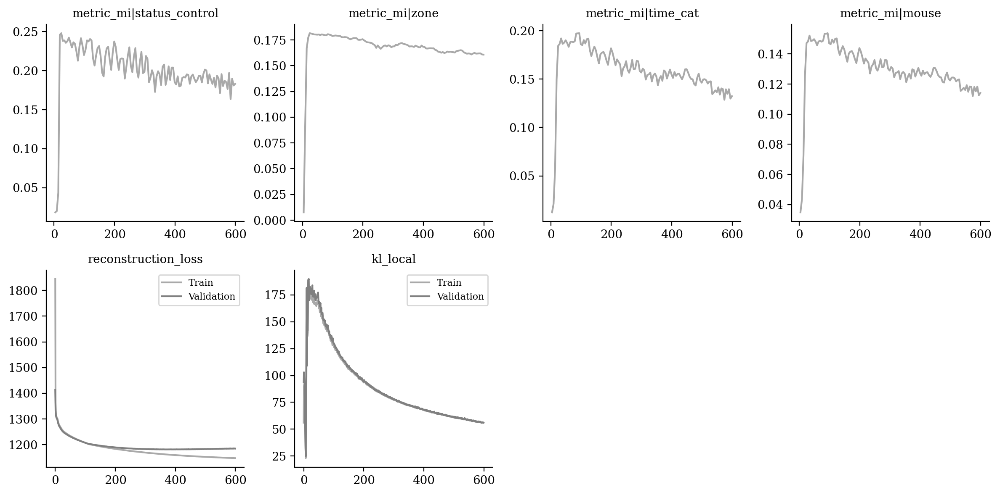

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

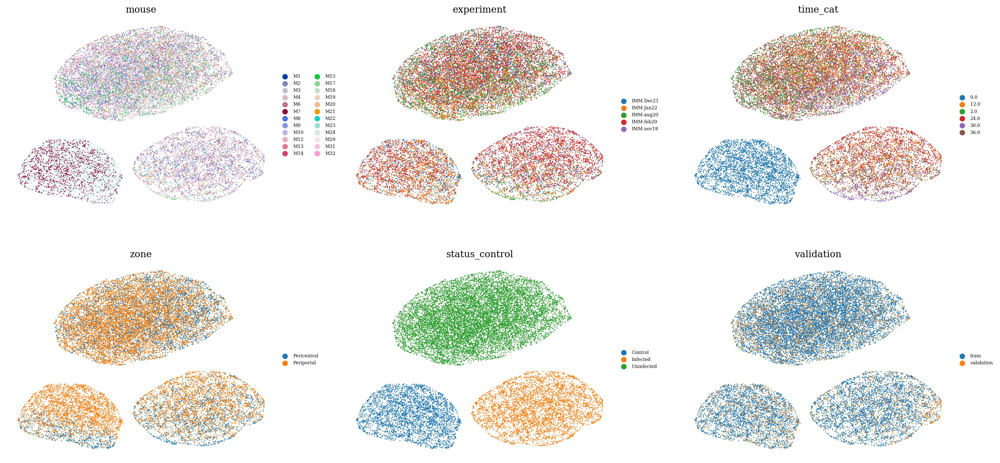

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

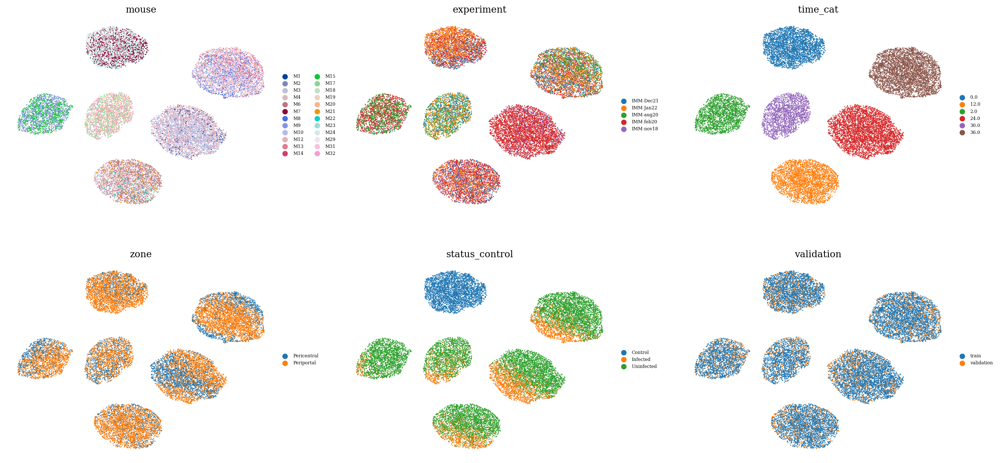

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

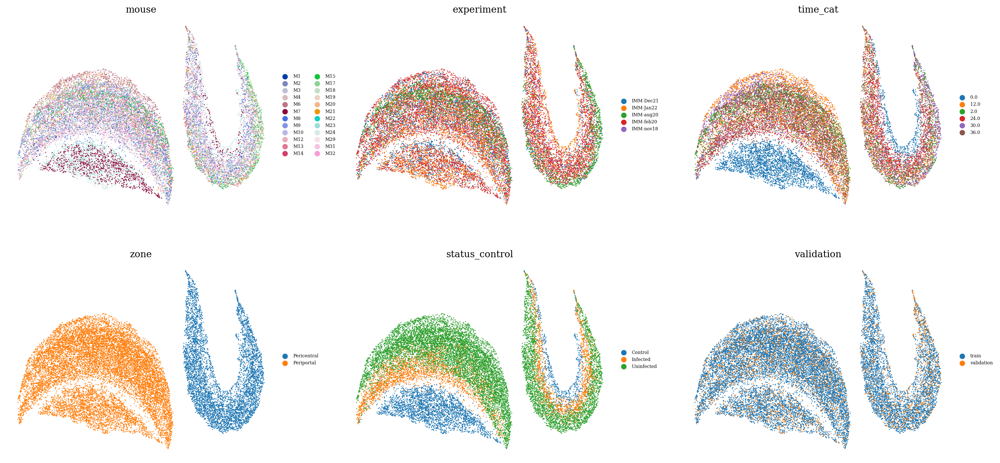

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

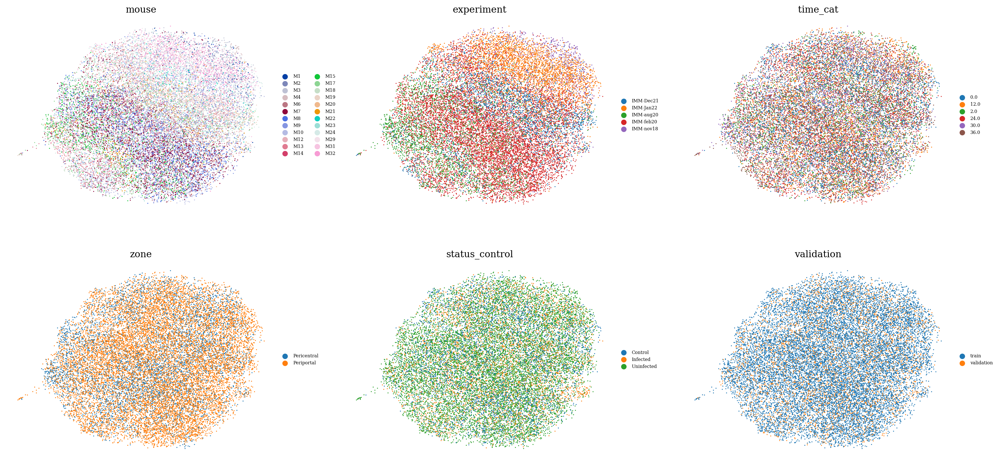

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

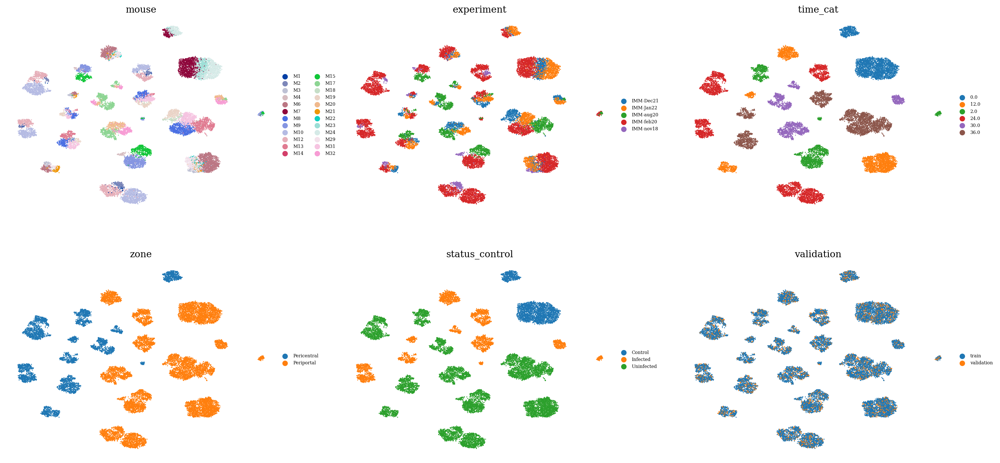

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8855288569570504

In [20]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.835351683079749

In [21]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9962610964682673,
 ('validation', 'unreserved'): 0.09298595879774943,
 ('train', 'reserved'): 0.9956097445582293,
 ('train', 'unreserved'): 0.045376272056847994}

In [22]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.9604437684468734,
 ('validation', 'unreserved'): 0.2005312554233008,
 ('train', 'reserved'): 0.956933692964885,
 ('train', 'unreserved'): 0.1484329565585198}

In [23]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9402747669484168,
 ('validation', 'unreserved'): 0.18639649777221715,
 ('train', 'reserved'): 0.94050385786415,
 ('train', 'unreserved'): 0.10507063262032883}